<center>
  <img src="airbnb_portada.png" alt="Imagen de análisis económico" width="320"/>
</center>


<h1 style="text-align:center; font-weight:bold;">
Predicción inteligente de precios en Airbnb para tiempos competitivos
</h1>



**Autor:** Diógenes Lugo<br>
**Programa:** Máster en Ciencia de Datos<br>
**Institución:** *KeepCoding*<br>
**Fecha:** 04-12-2025<br> 

---

### **Descripción**

Este notebook presenta una primera mirada al conjunto de datos de Airbnb para entender cómo se comportan los precios y prepararse para tiempos difíciles en los que decidir bien es clave. Se revisan aspectos esenciales como la ubicación, el tipo de alojamiento y el número de habitaciones, además de comprobar si faltan datos o si hay patrones que influyen en el valor final. También se crean algunas métricas sencillas que ayudan a conocer mejor el mercado y a preparar una base sólida para construir un modelo que prediga precios con buena precisión, optimizar su rendimiento y analizar sus errores para seguir mejorándolo.

---


In [2]:
# =============================================
# Configuración inicial del entorno
# =============================================

# Librerías principales
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.neighbors import KNeighborsRegressor
from collections import Counter
import random
import re

# Visualización
import matplotlib.pyplot as plt
import seaborn as sns

# Utilidades del sistema
import warnings
warnings.filterwarnings('ignore')

# =============================================
# Configuración de visualización
# =============================================

plt.style.use('seaborn-v0_8')
plt.rcParams['figure.figsize'] = (12, 6)
plt.rcParams['axes.titlesize'] = 14
plt.rcParams['axes.labelsize'] = 12
plt.rcParams['xtick.labelsize'] = 11
plt.rcParams['ytick.labelsize'] = 11
plt.rcParams['font.size'] = 11

pd.set_option('display.float_format', lambda x: f'{x:,.4f}')
pd.set_option('display.max_columns', 200)
pd.set_option('display.precision', 2)

## 1. Carga del Dataset
Primera visualización para entender la estrutura del dataset

In [4]:
data = pd.read_csv('airbnb-listings-extract.csv', sep=';', decimal='.')
data.head(7)

,ID,Listing Url,Scrape ID,Last Scraped,Name,Summary,Space,Description,Experiences Offered,Neighborhood Overview,Notes,Transit,Access,Interaction,House Rules,Thumbnail Url,Medium Url,Picture Url,XL Picture Url,Host ID,Host URL,Host Name,Host Since,Host Location,Host About,Host Response Time,Host Response Rate,Host Acceptance Rate,Host Thumbnail Url,Host Picture Url,Host Neighbourhood,Host Listings Count,Host Total Listings Count,Host Verifications,Street,Neighbourhood,Neighbourhood Cleansed,Neighbourhood Group Cleansed,City,State,Zipcode,Market,Smart Location,Country Code,Country,Latitude,Longitude,Property Type,Room Type,Accommodates,Bathrooms,Bedrooms,Beds,Bed Type,Amenities,Square Feet,Price,Weekly Price,Monthly Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Calendar Updated,Has Availability,Availability 30,Availability 60,Availability 90,Availability 365,Calendar last Scraped,Number of Reviews,First Review,Last Review,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,License,Jurisdiction Names,Cancellation Policy,Calculated host listings count,Reviews per Month,Geolocation,Features
0,11210388,https://www.airbnb.com/rooms/11210388,20170306202425,2017-03-07,The Loft-Full Bath-Deck w/View,Loft in the Hill country 12-15 minutes directl...,This loft has a spectacular view of the hills ...,Loft in the Hill country 12-15 minutes directl...,none,This neighborhood is located in the hills west...,The loft is located on a gated property. Ther...,There is no public transportation from this lo...,The loft is entirely private to the guest as i...,My wife and I live on the property so we would...,The loft is entirely private but is adjacent t...,https://a0.muscache.com/im/pictures/c351a9b5-5...,https://a0.muscache.com/im/pictures/c351a9b5-5...,https://public.opendatasoft.com/api/v2/catalog...,https://a0.muscache.com/im/pictures/c351a9b5-5...,58386783,https://www.airbnb.com/users/show/58386783,John,2016-02-11,My father was USAF so I was born at Offutt AFB...,I am a High Tech Professional with over 30 yea...,within an hour,100.0000,NaN,https://a0.muscache.com/im/pictures/c5c78f08-f...,https://a0.muscache.com/im/pictures/c5c78f08-f...,NaN,1.0000,1.0000,"email,phone,reviews,kba","Canyon Edge Drive, Austin, TX 78733, United St...",NaN,78733,NaN,Austin,TX,78733,Austin,"Austin, TX",US,United States,30.3374,-97.8633,Loft,Entire home/apt,2,1.0000,1.0000,1.0000,Real Bed,"TV,Cable TV,Internet,Wireless Internet,Air con...",NaN,58.0000,NaN,NaN,100.0000,NaN,1,0,2,1125,today,NaN,10,34,64,281,2017-03-06,42,2016-03-13,2017-02-26,98.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,NaN,NaN,moderate,1.0000,3.5000,"30.3373609355,-97.8632766782","Host Is Superhost,Host Has Profile Pic,Host Id..."
1,17471131,https://www.airbnb.com/rooms/17471131,20170407214050,2017-04-08,"Claris I, Friendly Rentals","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...","This apartment has: 1 double bed, 1 double sof...",none,Plaza Cataluña Catalonia Square is the large...,NaN,Ideal to discover the city either on foot or b...,Travellers will have access to the entire apar...,We will be more than happy to help you with an...,CHECK-IN Week Days: The check-in and key colle...,https://a0.muscache.com/im/pictures/3ce27aee-f...,https://a0.muscache.com/im/pictures/3ce27aee-f...,https://public.opendatasoft.com/api/v2/catalog...,https://a0.muscache.com/im/pictures/3ce27aee-f...,102947901,https://www.airbnb.com/users/show/102947901,Claudia,2016-11-08,"Barcelona, Catalonia, Spain",Hola a todos! Soy Claudia Castillo y soy parte...,within an hour,100.0000,NaN,https://a0.muscache.com/im/pictures/c071e13e-5...,https://a0.muscache.com/im/pictures/c071e13e-5...,NaN,162.0000,162.0000,"email,phone,reviews,work_email","Barcelona, Barcelona 08010, Spain",NaN,la Dreta de l'Eixample,Eixampl

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14780 entries, 0 to 14779
Data columns (total 89 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   ID                              14780 non-null  int64  
 1   Listing Url                     14780 non-null  object 
 2   Scrape ID                       14780 non-null  int64  
 3   Last Scraped                    14780 non-null  object 
 4   Name                            14779 non-null  object 
 5   Summary                         14189 non-null  object 
 6   Space                           10888 non-null  object 
 7   Description                     14774 non-null  object 
 8   Experiences Offered             14780 non-null  object 
 9   Neighborhood Overview           9134 non-null   object 
 10  Notes                           5644 non-null   object 
 11  Transit                         9066 non-null   object 
 12  Access                          

### Observaciones iniciales

- El dataset contiene un total de **89 columnas** y **11.824 entradas**.
- Muchas de estas columnas contienen información irrelavantes, entre ellas:
  - **IDs**: No aportan valor en términos predictivos.
  - **URLs**: Información de referencia que no influye en el precio.
  - **Información del Host**: No aporta relevancia directa al precio del alojamiento.
  - **Información del Scrap**: Datos de recolección que no afectan al modelo.


Se eliminarán aquellas que:

- No aportan valor al modelo (IDs, URLs, etc.).
- Están excesivamente incompletas (demasiados valores nulos).
- Son redundantes o duplicadas.

In [7]:
columnas_eliminar =["ID","Name","Summary","Space","Description","Neighborhood Overview","Notes","Interaction","Listing Url","Scrape ID","Last Scraped","Thumbnail Url","Medium Url","Picture Url","XL Picture Url","Host ID","Host URL","Host Name","Host Since","Host Location","Host About","Host Response Time", "Host Response Rate","Host Acceptance Rate","Host Thumbnail Url","Host Picture Url","Host Neighbourhood","Host Listings Count","Host Total Listings Count","Host Verifications","Calendar last Scraped","First Review","Last Review","License","Jurisdiction Names","Calendar Updated"]
data_v1 =  data.drop(columns=columnas_eliminar)
data_v1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14780 entries, 0 to 14779
Data columns (total 53 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Experiences Offered             14780 non-null  object 
 1   Transit                         9066 non-null   object 
 2   Access                          8318 non-null   object 
 3   House Rules                     9619 non-null   object 
 4   Street                          14780 non-null  object 
 5   Neighbourhood                   9551 non-null   object 
 6   Neighbourhood Cleansed          14780 non-null  object 
 7   Neighbourhood Group Cleansed    13760 non-null  object 
 8   City                            14774 non-null  object 
 9   State                           14636 non-null  object 
 10  Zipcode                         14274 non-null  object 
 11  Market                          14723 non-null  object 
 12  Smart Location                  

## 2. Visualización de Valores Nulos

Para identificar las columnas que presentan un alto porcentaje de valores nulos, calculamos el porcentaje de nulos por cada campo. Asi se detectan columnas con muchos datos faltantes que perjudican al modelo de manera de eliminarlo luego.

In [9]:
nulos_porcentaje = (data_v1.isnull().mean() * 100).sort_values(ascending = False)
nulos_porcentaje

Has Availability                 99.9188
Square Feet                      95.9540
Monthly Price                    75.9066
Weekly Price                     75.7104
Security Deposit                 57.6725
Access                           43.7212
Cleaning Fee                     41.2246
Transit                          38.6604
Neighbourhood                    35.3789
House Rules                      34.9188
Review Scores Value              22.6049
Review Scores Location           22.5981
Review Scores Checkin            22.5778
Review Scores Accuracy           22.5034
Review Scores Cleanliness        22.4628
Review Scores Communication      22.4628
Review Scores Rating             22.3545
Reviews per Month                21.3938
Neighbourhood Group Cleansed      6.9012
Zipcode                           3.4235
Amenities                         1.1502
State                             0.9743
Market                            0.3857
Bathrooms                         0.3721
Beds            

## 3. Eliminación de Columnas con Más del 50% de Valores Nulos

Para optimizar el modelo y reducir el ruido en los datos, se eliminan aquellas columnas que presentan un **50% o más de valores nulos**. Ya que estes no serían confiables o no estas disponibles mayormente, aún asi, la columna `Security Deposit` se mantine por su valor conceptual en el analisis, luego se vera si se borra o no.



In [11]:
columnas_eliminar =["Has Availability","Square Feet","Monthly Price","Weekly Price","Access","Transit","Neighbourhood","House Rules"]
data_v2 =  data_v1.drop(columns=columnas_eliminar)
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14780 entries, 0 to 14779
Data columns (total 45 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Experiences Offered             14780 non-null  object 
 1   Street                          14780 non-null  object 
 2   Neighbourhood Cleansed          14780 non-null  object 
 3   Neighbourhood Group Cleansed    13760 non-null  object 
 4   City                            14774 non-null  object 
 5   State                           14636 non-null  object 
 6   Zipcode                         14274 non-null  object 
 7   Market                          14723 non-null  object 
 8   Smart Location                  14780 non-null  object 
 9   Country Code                    14780 non-null  object 
 10  Country                         14779 non-null  object 
 11  Latitude                        14780 non-null  float64
 12  Longitude                       

## 4. Eliminación de Columnas Redundantes

Para reducir la dimensionalidad y evitar duplicidades, se eliminaron varias columnas que no aportaban valor predictivo: **Experiences Offered**, cuyos valores eran siempre “none” luego, **Street, Neighbourhood Group Cleansed, State, Smart Location, Country Code, Country, Geolocation, Zipcode, City y Market**, ya que su información se encuentra representada de forma más útil y consolidada en variables como Neighbourhood Cleansed, Latitude y Longitude, por lo que mantenerlas solo añadiría ruido e irrelevancia al modelo.


In [13]:

columnas_redundantes = [
    "Experiences Offered","City","Market",
    "Street", "Neighbourhood Group Cleansed", 
    "State", "Smart Location", "Zipcode",
    "Country Code", "Country", "Geolocation"
]
data_v2 = data_v2.drop(columns=columnas_redundantes)
data_v2.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14780 entries, 0 to 14779
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Neighbourhood Cleansed          14780 non-null  object 
 1   Latitude                        14780 non-null  float64
 2   Longitude                       14780 non-null  float64
 3   Property Type                   14780 non-null  object 
 4   Room Type                       14780 non-null  object 
 5   Accommodates                    14780 non-null  int64  
 6   Bathrooms                       14725 non-null  float64
 7   Bedrooms                        14755 non-null  float64
 8   Beds                            14731 non-null  float64
 9   Bed Type                        14780 non-null  object 
 10  Amenities                       14610 non-null  object 
 11  Price                           14763 non-null  float64
 12  Security Deposit                

## 5. Exploración de la Variable Objetivo: Price

Para entender mejor la distribución de precios, generamos un histograma con un suavizado de densidad (KDE) que nos permitirá identificar:
- Asimetrías en los precios.
- Colas largas (valores muy altos).
- Picos que puedan indicar comportamientos atípicos.



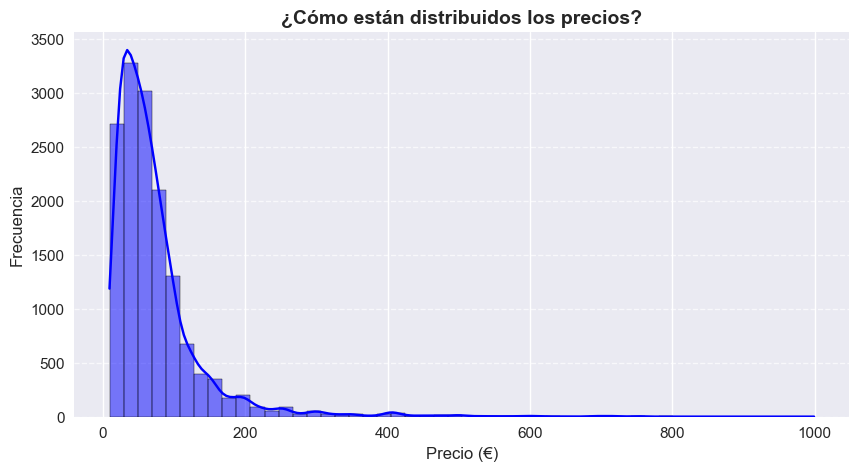

In [15]:
plt.figure(figsize=(10, 5))
sns.histplot(data_v2['Price'], bins=50, kde=True, color='blue')
plt.title('¿Cómo están distribuidos los precios?', fontsize=14, fontweight='bold')
plt.xlabel('Precio (€)')
plt.ylabel('Frecuencia')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

## 6. Detección de Outliers con Histogramas y Boxplot

Para identificar posibles valores atípicos en los precios, se generaron varios histogramas y un diagrama de caja, complementados con el cálculo de percentiles para determinar dónde se sitúan los importes más elevados. En este análisis, el **percentil 99** se establece como límite superior para detectar outliers, ya que los precios que superan dicho umbral pueden introducir distorsiones en el modelo.


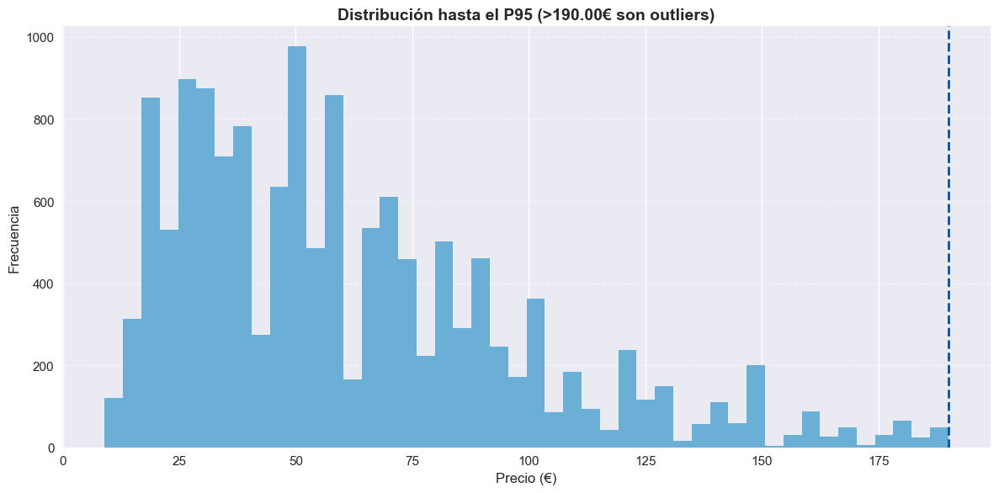

In [17]:
prices = data_v2["Price"].dropna()
p95 = prices.quantile(0.95)

plt.hist(
    prices[prices <= p95],
    bins="fd",
    color="#6BAED6"  
)

plt.axvline(
    p95,
    ls="--",
    color="#08519C",   
    linewidth=2
)

plt.xlabel("Precio (€)")
plt.ylabel("Frecuencia")
plt.title(f"Distribución hasta el P95 (>{p95:.2f}€ son outliers)", fontsize=14, fontweight='bold')
plt.grid(axis="y", linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()


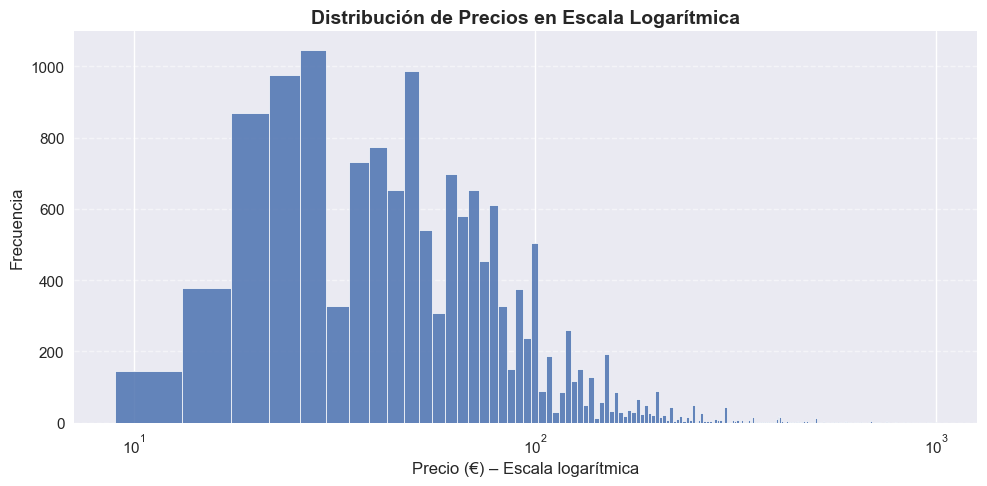

In [18]:
plt.figure(figsize=(10, 5))

plt.hist(
    prices,
    bins="auto",
    color="#4C72B0", 
    alpha=0.85,
    edgecolor="white",
    linewidth=0.6
)

plt.xscale("log")

plt.title("Distribución de Precios en Escala Logarítmica", fontsize=14, fontweight='bold')
plt.xlabel("Precio (€) – Escala logarítmica", fontsize=12)
plt.ylabel("Frecuencia", fontsize=12)

plt.grid(axis="y", linestyle="--", alpha=0.5)

plt.tight_layout()
plt.show()

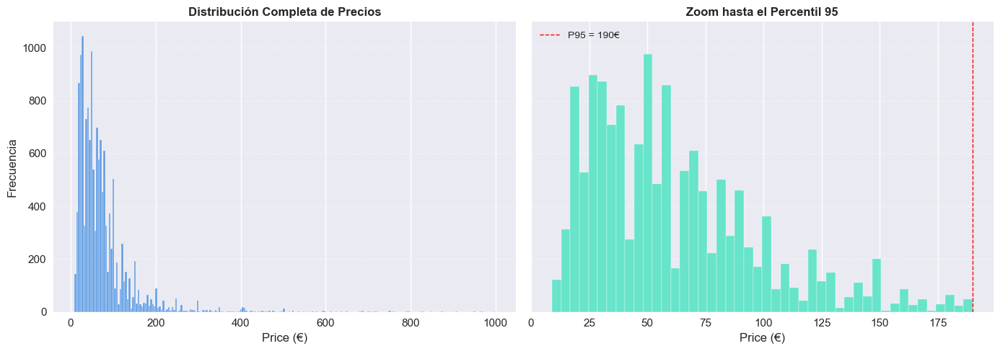

In [19]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5), sharey=True)

# ---- Histograma completo ----
ax1.hist(prices, bins="fd", color="#4A90E2", edgecolor="white", alpha=0.85)
ax1.set_title("Distribución Completa de Precios", fontsize=12, weight="bold")
ax1.set_xlabel("Price (€)")
ax1.set_ylabel("Frecuencia")
ax1.grid(axis="y", linestyle="--", alpha=0.4)

# ---- Histograma acotado al P95 ----
ax2.hist(prices[prices <= p95], bins="fd", color="#50E3C2", edgecolor="white", alpha=0.85)
ax2.axvline(p95, color="red", linestyle="--", linewidth=1, label=f"P95 = {p95:.0f}€")
ax2.set_title("Zoom hasta el Percentil 95", fontsize=12, weight="bold")
ax2.set_xlabel("Price (€)")
ax2.grid(axis="y", linestyle="--", alpha=0.4)
ax2.legend(frameon=False)

plt.tight_layout()
plt.show()

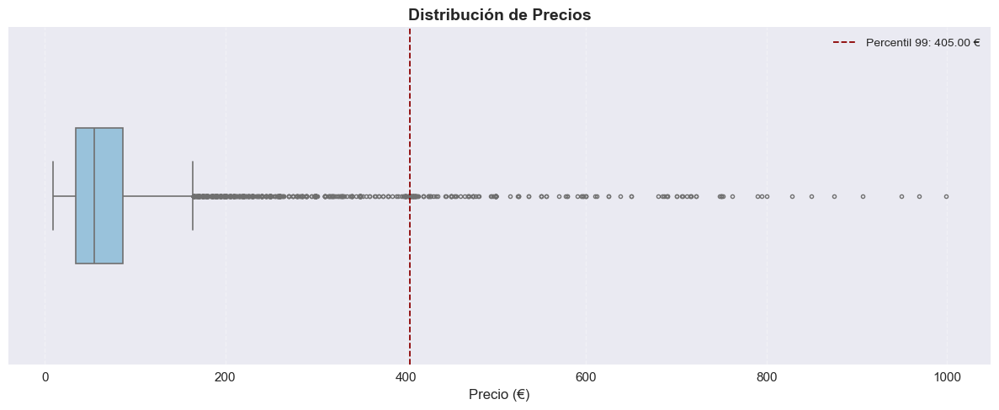

Estadístico de percentiles del precio:

P25: 34.00 €
P50 (mediana): 55.00 €
P75: 86.00 €
P90: 135.00 €
P95: 190.00 €
P99: 405.00 €


In [20]:
precio_sin_nulos = data_v2['Price'].dropna()

# --- Boxplot mejorado ---
plt.figure(figsize=(12, 5))
sns.boxplot(
    x=precio_sin_nulos,
    color='#8EC4E6',
    width=0.4,
    fliersize=3,           
    linewidth=1.2
)

# Línea vertical para el P99
p99 = np.percentile(precio_sin_nulos, 99)
plt.axvline(
    p99,
    color='darkred',
    linestyle='--',
    linewidth=1.3,
    label=f'Percentil 99: {p99:.2f} €'
)

plt.title("Distribución de Precios", fontsize=14, fontweight='bold')
plt.xlabel('Precio (€)', fontsize=12)
plt.legend()
plt.grid(axis='x', linestyle='--', alpha=0.35)
plt.tight_layout()
plt.show()

# --- Percentiles de referencia para entender la distribución del precio ---
print("Estadístico de percentiles del precio:\n")

percentiles = np.percentile(precio_sin_nulos, [25, 50, 75, 90, 95, 99])

for label, value in zip(["P25", "P50 (mediana)", "P75", "P90", "P95", "P99"], percentiles):
    print(f"{label}: {value:.2f} €")

## 7. Eliminación de Outliers

Para evitar que el modelo se vea distorsionado, se eliminan los precios que superan el percentil 99, equivalente a 299 €, asegurando así que los valores extremadamente altos no afecten el entrenamiento.


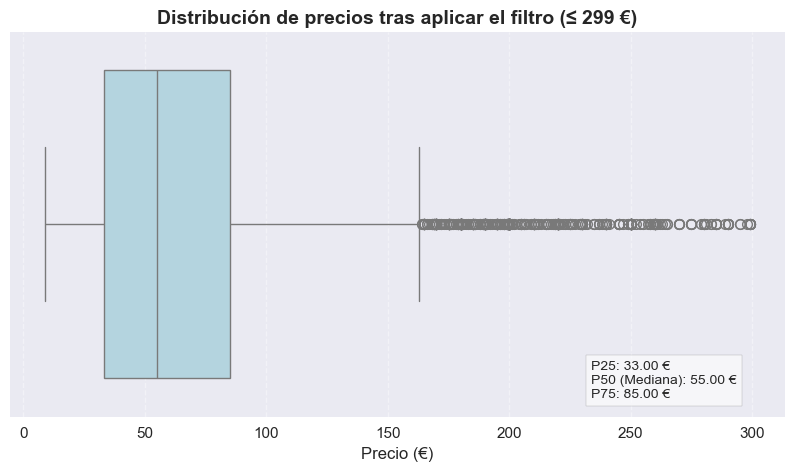

In [22]:
# Datos filtrados
data_v2 = data_v2[data_v2['Price'] <= 299]

# Visualización mejorada
plt.figure(figsize=(10, 5))
sns.boxplot(x=data_v2['Price'], color='lightblue')

plt.title('Distribución de precios tras aplicar el filtro (≤ 299 €)', fontsize=14, fontweight='bold')
plt.xlabel('Precio (€)', fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.4)

p25, p50, p75 = np.percentile(data_v2['Price'], [25, 50, 75])
plt.text(
    0.75, 0.05,  # x=0.75 (derecha), y=0.05 (abajo)
    f"P25: {p25:.2f} €\nP50 (Mediana): {p50:.2f} €\nP75: {p75:.2f} €",
    transform=plt.gca().transAxes,
    fontsize=10,
    bbox=dict(facecolor='white', alpha=0.6, edgecolor='gray') 
)
plt.show()


In [23]:
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14483 entries, 0 to 14779
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Neighbourhood Cleansed          14483 non-null  object 
 1   Latitude                        14483 non-null  float64
 2   Longitude                       14483 non-null  float64
 3   Property Type                   14483 non-null  object 
 4   Room Type                       14483 non-null  object 
 5   Accommodates                    14483 non-null  int64  
 6   Bathrooms                       14430 non-null  float64
 7   Bedrooms                        14458 non-null  float64
 8   Beds                            14436 non-null  float64
 9   Bed Type                        14483 non-null  object 
 10  Amenities                       14373 non-null  object 
 11  Price                           14483 non-null  float64
 12  Security Deposit                6174 

## 8. Imputación de Valores Nulos en Variables Numéricas
Luego del analisis anterior para completar los valores nulos en las variables numéricas (**Bathrooms, Bedrooms, Beds y Price**) se utilizó la mediana, dado que es más robusta frente a outliers y refleja de manera más fiel el valor típico.


In [25]:
data_v2['Bathrooms'] = data_v2['Bathrooms'].fillna(data_v2['Bathrooms'].median())
data_v2['Bedrooms'] = data_v2['Bedrooms'].fillna(data_v2['Bedrooms'].median())
data_v2['Beds'] = data_v2['Beds'].fillna(data_v2['Beds'].median())
data_v2['Price'] = data_v2['Price'].fillna(data_v2['Price'].median())

In [26]:
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 14483 entries, 0 to 14779
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Neighbourhood Cleansed          14483 non-null  object 
 1   Latitude                        14483 non-null  float64
 2   Longitude                       14483 non-null  float64
 3   Property Type                   14483 non-null  object 
 4   Room Type                       14483 non-null  object 
 5   Accommodates                    14483 non-null  int64  
 6   Bathrooms                       14483 non-null  float64
 7   Bedrooms                        14483 non-null  float64
 8   Beds                            14483 non-null  float64
 9   Bed Type                        14483 non-null  object 
 10  Amenities                       14373 non-null  object 
 11  Price                           14483 non-null  float64
 12  Security Deposit                6174 

## 9. Análisis de Security Deposit y Cleaning Fee
Las variables **Security Deposit y Cleaning Fee** contienen numerosos valores nulos, pero se estima que ambas pueden tener un impacto significativo en la precisión del modelo al predecir el precio. Antes de imputar los datos faltantes, se procederá a visualizar su distribución para determinar la estrategia de imputación más adecuada, ya sea media, mediana, cero, categórica, etc.

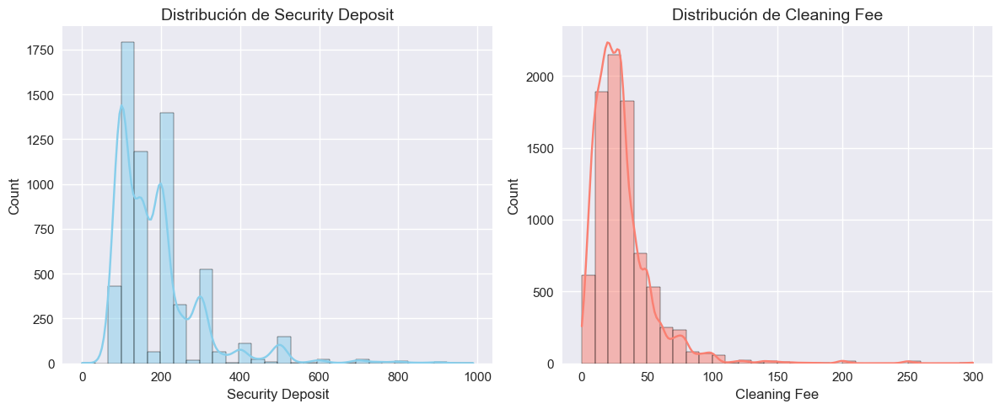

In [28]:
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(data_v2['Security Deposit'], bins=30, kde=True, color='skyblue')
plt.title('Distribución de Security Deposit')
plt.subplot(1, 2, 2)
sns.histplot(data_v2['Cleaning Fee'], bins=30, kde=True, color='salmon')
plt.title('Distribución de Cleaning Fee')

plt.tight_layout()
plt.show()

## 10.  Detección de outliers en Security Deposit y Cleaning Fee
Para identificar los outliers, generamos un **Boxplot** y calculamos los **percentiles**. 
Los valores por encima del percentil 99 serán considerados como extremos.


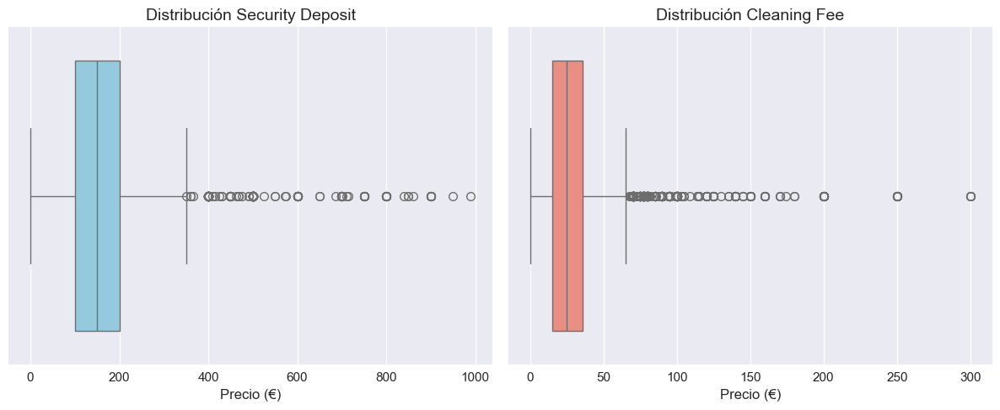

Percentiles - Security Deposit:
P25: 100.00 €
P50 (mediana): 150.00 €
P75: 200.00 €
P90: 300.00 €
P95: 400.00 €
P99: 650.00 €

Percentiles - Cleaning Fee:
P25: 15.00 €
P50 (mediana): 25.00 €
P75: 36.00 €
P90: 50.00 €
P95: 70.00 €
P99: 120.00 €


In [30]:
# --- Boxplots ---
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
sns.boxplot(x=data_v2['Security Deposit'], color='skyblue')
plt.title('Distribución Security Deposit')
plt.xlabel('Precio (€)')

plt.subplot(1, 2, 2)
sns.boxplot(x=data_v2['Cleaning Fee'], color='salmon')
plt.title('Distribución Cleaning Fee')
plt.xlabel('Precio (€)')

plt.tight_layout()
plt.show()

# --- Percentiles de Security Deposit ---
print("Percentiles - Security Deposit:")
percentiles_sd = np.percentile(data_v2['Security Deposit'].dropna(), [25, 50, 75, 90, 95, 99])
for label, value in zip(["P25", "P50 (mediana)", "P75", "P90", "P95", "P99"], percentiles_sd):
    print(f"{label}: {value:.2f} €")

# --- Percentiles de Cleaning Fee ---
print("\nPercentiles - Cleaning Fee:")
percentiles_cf = np.percentile(data_v2['Cleaning Fee'].dropna(), [25, 50, 75, 90, 95, 99])
for label, value in zip(["P25", "P50 (mediana)", "P75", "P90", "P95", "P99"], percentiles_cf):
    print(f"{label}: {value:.2f} €")


## 11.1 Extracción de valores extremos con KNN
Para imputar los valores extremos se empleará un modelo de K-Neighbors Regressor, de manera que los outliers sean reemplazados por estimaciones basadas en propiedades con características similares, tales como **Bedrooms, Bathrooms, Beds, Accommodates y Price.** Se establecen los siguientes límites para identificar los outliers: Security Deposit → 600 € y Cleaning Fee → 100 €.


In [32]:
features = ['Bedrooms', 'Bathrooms', 'Beds', 'Accommodates', 'Price']

limite_sd = 600
limite_cf = 100

outliers_sd = data_v2[data_v2['Security Deposit'] > limite_sd]
inliers_sd = data_v2[data_v2['Security Deposit'] <= limite_sd]

outliers_cf = data_v2[data_v2['Cleaning Fee'] > limite_cf]
inliers_cf = data_v2[data_v2['Cleaning Fee'] <= limite_cf]

X_train_sd = inliers_sd[features]
y_train_sd = inliers_sd['Security Deposit']
X_test_sd = outliers_sd[features]

X_train_cf = inliers_cf[features]
y_train_cf = inliers_cf['Cleaning Fee']
X_test_cf = outliers_cf[features]

knn_model_sd = KNeighborsRegressor(n_neighbors=5)
knn_model_sd.fit(X_train_sd, y_train_sd)
y_pred_knn_sd = knn_model_sd.predict(X_test_sd)

knn_model_cf = KNeighborsRegressor(n_neighbors=5)
knn_model_cf.fit(X_train_cf, y_train_cf)
y_pred_knn_cf = knn_model_cf.predict(X_test_cf)

data_v2.loc[data_v2['Security Deposit'] > limite_sd, 'Security Deposit'] = y_pred_knn_sd
data_v2.loc[data_v2['Cleaning Fee'] > limite_cf, 'Cleaning Fee'] = y_pred_knn_cf

## 11.2 Extracción de valores muy bajos en la variable "Price" y lógica sobre "Security Deposit"
Para los valores extremos inferiores se optó por un técnica sencilla de filtrado con la siguiente lógica, un piso no puede costar menos de 15€ la noche, además, es muy raro que te cobren más de seis veces el valor del alquier del piso como depósito de seguridad para cubrir daños.

In [34]:
data_v2[data_v2["Security Deposit"] > 6 * data_v2["Price"]].head(5)

,Neighbourhood Cleansed,Latitude,Longitude,Property Type,Room Type,Accommodates,Bathrooms,Bedrooms,Beds,Bed Type,Amenities,Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Availability 30,Availability 60,Availability 90,Availability 365,Number of Reviews,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,Cancellation Policy,Calculated host listings count,Reviews per Month,Features
7,la Sagrada Família,41.4024,2.1711,Apartment,Private room,2,1.0000,1.0000,1.0000,Real Bed,"TV,Internet,Wireless Internet,Air conditioning...",45.0000,300.0000,30.0000,1,20,3,7,13,38,66,66,29,96.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,flexible,1.0000,0.6400,"Host Has Profile Pic,Is Location Exact,Require..."
85,Entrevías,40.3841,-3.6702,Apartment,Private room,4,1.0000,1.0000,3.0000,Real Bed,"Air conditioning,Kitchen,Heating,Family/kid fr...",48.0000,300.0000,NaN,2,0,1,1125,4,4,26,161,2,50.0000,5.0000,5.0000,7.0000,4.0000,5.0000,4.0000,strict,4.0000,0.3200,"Host Has Profile Pic,Host Identity Verified,Is..."
147,Casco Histórico de Vicálvaro,40.3979,-3.6232,Apartment,Private room,1,1.0000,1.0000,1.0000,Real Bed,"Cable TV,Wireless Internet,Air conditioning,Wh...",20.0000,350.0000,10.0000,1,20,1,1125,0,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,flexible,1.0000,NaN,"Host Has Profile Pic,Is Location Exact,Require..."
177,Valdefuentes,40.4973,-3.6560,Apartment,Entire home/apt,5,2.0000,3.0000,3.0000,Real Bed,"TV,Wireless Internet,Air conditioning,Wheelcha...",73.0000,500.0000,30.0000,1,15,7,60,15,45,75,350,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,strict,3.0000,NaN,"Host Has Profile Pic,Is Location Exact,Require..."
219,Sol,40.4195,-3.7012,Apartment,Private room,1,5.0000,1.0000,1.0000,Real Bed,"TV,Wireless Internet,Air conditioning,Kitchen,...",22.0000,200.0000,NaN,1,0,4,1125,0,0,10,10,1,100.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,strict,38.0000,0.0400,"Host Has Profile Pic,Is Location Exact,Require..."


In [35]:
# Condición: Price < 15 o Security_deposit > 5 * Price
cond = (data_v2["Price"] < 15) | (data_v2["Security Deposit"] > 5 * data_v2["Price"])

# Ver cuántas filas cumplen la condición
print("Filas a eliminar:", cond.sum())

# Eliminar las filas directamente
data_v2 = data_v2.drop(data_v2[cond].index)

# Verificar nuevo tamaño del dataset
print("Filas restantes:", len(data_v2))

Filas a eliminar: 809
Filas restantes: 13674


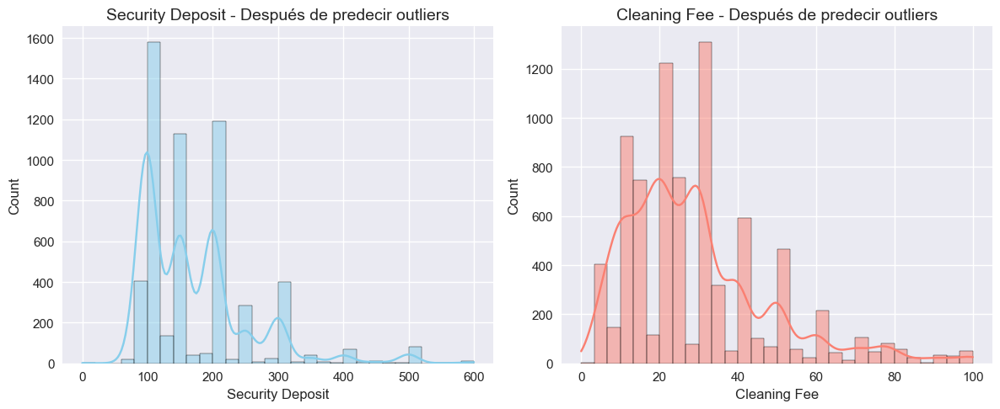

In [36]:
# Nueva visualizacion con valores extremos corregidos

plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(data_v2['Security Deposit'], bins=30, kde=True, color='skyblue')
plt.title('Security Deposit - Después de predecir outliers')

plt.subplot(1, 2, 2)
sns.histplot(data_v2['Cleaning Fee'], bins=30, kde=True, color='salmon')
plt.title('Cleaning Fee - Después de predecir outliers')

plt.tight_layout()
plt.show()

## 12. Extracción de valores NAN con KNN
Para completar los valores nulos en las variables Security Deposit y Cleaning Fee se empleará la misma lógica con un modelo de K-Neighbors Regressor (KNN), el cual se entrenará utilizando las características **Bedrooms, Bathrooms, Beds, Accommodates y Price.**

In [38]:
features = ['Bedrooms', 'Bathrooms', 'Beds', 'Accommodates', 'Price']

train_data_sd = data_v2[data_v2['Security Deposit'].notna()]
test_data_sd = data_v2[data_v2['Security Deposit'].isna()]
X_train_sd = train_data_sd[features]
y_train_sd = train_data_sd['Security Deposit']
X_test_sd = test_data_sd[features]


knn_model_sd = KNeighborsRegressor(n_neighbors=5)
knn_model_sd.fit(X_train_sd, y_train_sd)

y_pred_knn_sd = knn_model_sd.predict(X_test_sd)
data_v2.loc[data_v2['Security Deposit'].isna(), 'Security Deposit'] = y_pred_knn_sd


train_data_cf = data_v2[data_v2['Cleaning Fee'].notna()]
test_data_cf = data_v2[data_v2['Cleaning Fee'].isna()]
X_train_cf = train_data_cf[features]
y_train_cf = train_data_cf['Cleaning Fee']
X_test_cf = test_data_cf[features]

knn_model_cf = KNeighborsRegressor(n_neighbors=5)
knn_model_cf.fit(X_train_cf, y_train_cf)

y_pred_knn_cf = knn_model_cf.predict(X_test_cf)
data_v2.loc[data_v2['Cleaning Fee'].isna(), 'Cleaning Fee'] = y_pred_knn_cf


data_v2[['Security Deposit', 'Cleaning Fee']].isnull().sum()


Security Deposit    0
Cleaning Fee        0
dtype: int64

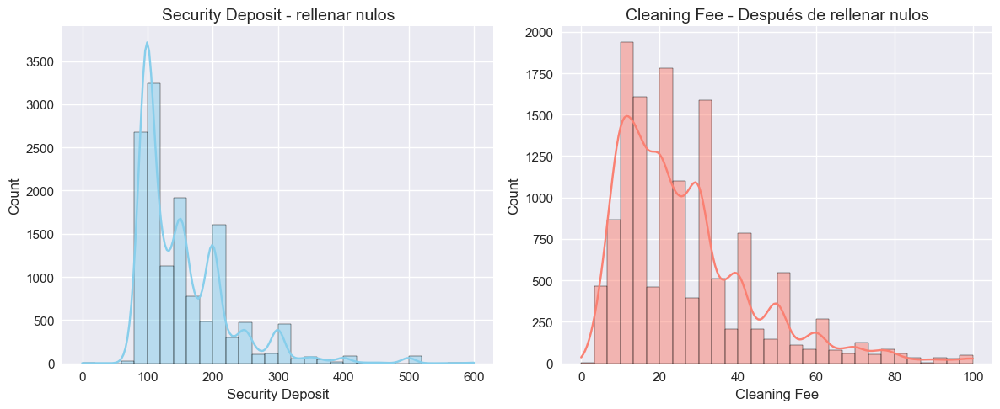

In [39]:
# Nueva visualizacion con valores NAN corregidos
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
sns.histplot(data_v2['Security Deposit'], bins=30, kde=True, color='skyblue')
plt.title('Security Deposit - rellenar nulos')

plt.subplot(1, 2, 2)
sns.histplot(data_v2['Cleaning Fee'], bins=30, kde=True, color='salmon')
plt.title('Cleaning Fee - Después de rellenar nulos')

plt.tight_layout()
plt.show()

In [40]:
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13674 entries, 0 to 14779
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Neighbourhood Cleansed          13674 non-null  object 
 1   Latitude                        13674 non-null  float64
 2   Longitude                       13674 non-null  float64
 3   Property Type                   13674 non-null  object 
 4   Room Type                       13674 non-null  object 
 5   Accommodates                    13674 non-null  int64  
 6   Bathrooms                       13674 non-null  float64
 7   Bedrooms                        13674 non-null  float64
 8   Beds                            13674 non-null  float64
 9   Bed Type                        13674 non-null  object 
 10  Amenities                       13572 non-null  object 
 11  Price                           13674 non-null  float64
 12  Security Deposit                13674

## 13. Imputación de Review Scores
Para las columnas de puntuaciones (Review Scores) se aplica un procedimiento diferente: se genera para cada una una columna binaria que indica si el alojamiento dispone de una valoración (1) o no (0), y los valores nulos de las columnas originales se sustituyen por -1 para identificar aquellos casos en los que aún no existen reseñas.

In [42]:
columnas_reviews = [
    'Review Scores Rating', 'Review Scores Accuracy',
    'Review Scores Cleanliness', 'Review Scores Checkin',
    'Review Scores Communication', 'Review Scores Location',
    'Review Scores Value','Reviews per Month'
]

for col in columnas_reviews:
    data_v2[f'Has_{col}'] = data_v2[col].notna().astype(int)
    # Imputar con -1 para representar "No review"
    data_v2[col] = data_v2[col].fillna(-1)

#Observacion del df
data_v2[columnas_reviews + [f'Has_{col}' for col in columnas_reviews]].head()

,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,Reviews per Month,Has_Review Scores Rating,Has_Review Scores Accuracy,Has_Review Scores Cleanliness,Has_Review Scores Checkin,Has_Review Scores Communication,Has_Review Scores Location,Has_Review Scores Value,Has_Reviews per Month
0,98.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,3.5000,1,1,1,1,1,1,1,1
1,80.0000,8.0000,10.0000,10.0000,10.0000,8.0000,10.0000,0.8600,1,1,1,1,1,1,1,1
2,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,0,0,0,0,0,0,0,0
3,92.0000,10.0000,9.0000,10.0000,10.0000,10.0000,9.0000,1.0900,1,1,1,1,1,1,1,1
4,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,-1.0000,0,0,0,0,0,0,0,0


## 14. Imputación de Amenities
Para incorporar la información de las comodidades de cada alojamiento, se identifican todas las amenities y se calcula su frecuencia, se seleccionan las 20 más habituales, se generan columnas binarias que indiquen su presencia o ausencia en cada propiedad y, por último, se elimina la columna original al quedar su contenido completamente desglosado.

In [44]:
# Función para convertir cada lista/string de amenities en una lista limpia
def limpiar_amenity(a):
    if pd.isna(a):
        return []
    
    # Forzar a string
    s = str(a)
    
    # Eliminar patrones como "translation missing: ... "
    s = re.sub(r'translation missing:[^,;]*', '', s, flags=re.IGNORECASE)
    
    # Separación en caso de que venga en formato de lista
    parts = re.split(r',|\;|\[|\]', s)
    
    # Normalización
    parts = [p.strip() for p in parts if p.strip() != ""]
    return parts

# Expandir todos los amenities en una sola lista limpia
lista_amenities = []
for x in data_v2['Amenities']:
    lista_amenities.extend(limpiar_amenity(x))

# Contar
amenities_counter = Counter(lista_amenities)

# Top 20
df_top20 = pd.DataFrame(
    amenities_counter.most_common(20),
    columns=['Amenity', 'Count']
)

df_top20

,Amenity,Count
0,Wireless Internet,12902
1,Kitchen,12648
2,Heating,12387
3,Essentials,11867
4,Washer,11627
5,TV,10774
6,Hangers,9067
7,Shampoo,8679
8,Family/kid friendly,8429
9,Elevator in building,7988


## 15. Selección de las 20 más comunes:
Las más frecuentes son seleccionadas para crear columnas binarias.  


In [46]:
top_20_amenities = [
    'Wireless Internet',
    'Kitchen',
    'Heating',
    'Essentials',
    'Washer',
    'TV',
    'Hangers',
    'Shampoo',
    'Family/kid friendly',
    'Elevator in building',
    'Iron',
    'Internet',
    'Hair dryer',
    'Air conditioning',
    'Laptop friendly workspace',
    'Buzzer/wireless intercom',
    'Smoking allowed',
    'First aid kit',
    '24-hour check-in',
    'Dryer'
]

for amenity in top_20_amenities:
    data_v2[f'Amenity_{amenity}'] = data_v2['Amenities'].apply(lambda x: 1 if pd.notna(x) and amenity in x else 0)

data_v2 = data_v2.drop(columns=['Amenities'])


In [47]:
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13674 entries, 0 to 14779
Data columns (total 61 columns):
 #   Column                             Non-Null Count  Dtype  
---  ------                             --------------  -----  
 0   Neighbourhood Cleansed             13674 non-null  object 
 1   Latitude                           13674 non-null  float64
 2   Longitude                          13674 non-null  float64
 3   Property Type                      13674 non-null  object 
 4   Room Type                          13674 non-null  object 
 5   Accommodates                       13674 non-null  int64  
 6   Bathrooms                          13674 non-null  float64
 7   Bedrooms                           13674 non-null  float64
 8   Beds                               13674 non-null  float64
 9   Bed Type                           13674 non-null  object 
 10  Price                              13674 non-null  float64
 11  Security Deposit                   13674 non-null  float64


## 16. Codificación de Variables Categóricas

Para permitir que el modelo de Machine Learning procese las variables categóricas, se aplica One-Hot Encoding. Este procedimiento convierte cada categoría en una columna binaria que señala su presencia con 1 y su ausencia con 0.

In [49]:
columnas_categoricas = ['Property Type',
    'Room Type', 'Bed Type', 'Cancellation Policy']

for col in columnas_categoricas:
    print(f"\n Categorías en '{col}':")
    display(data_v2[col].value_counts())



 Categorías en 'Property Type':


Property Type
Apartment             11130
House                  1202
Condominium             341
Bed & Breakfast         331
Loft                    289
Other                   201
Guesthouse               41
Dorm                     35
Chalet                   23
Townhouse                17
Hostel                   16
Serviced apartment       13
Villa                    10
Boutique hotel            6
Boat                      4
Guest suite               3
Casa particular           3
Earth House               3
Camper/RV                 2
Bungalow                  2
Tent                      1
Timeshare                 1
Name: count, dtype: int64


 Categorías en 'Room Type':


Room Type
Entire home/apt    8549
Private room       4987
Shared room         138
Name: count, dtype: int64


 Categorías en 'Bed Type':


Bed Type
Real Bed         13375
Pull-out Sofa      239
Futon               40
Couch               16
Airbed               4
Name: count, dtype: int64


 Categorías en 'Cancellation Policy':


Cancellation Policy
strict             5178
flexible           4354
moderate           4032
strict_new           33
super_strict_60      24
moderate_new         20
super_strict_30      19
flexible_new         14
Name: count, dtype: int64

## 17. Categorización con One-Hot Encoding
Se utiliza **OneHotEncoder**, que genera columnas binarias para cada categoría y, para evitar multicolinealidad, elimina la primera categoría (drop='first'); el resultado es un conjunto de nuevas variables que indican si cada registro pertenece a una categoría específica.


In [51]:
cols_to_encode = ['Property Type', 'Room Type', 'Bed Type', 'Cancellation Policy']

encoder = OneHotEncoder(sparse_output=False, drop='first')
encoded_data = encoder.fit_transform(data_v2[cols_to_encode])
encoded_cols = encoder.get_feature_names_out(cols_to_encode)


encoded_df = pd.DataFrame(encoded_data, columns=encoded_cols, index=data_v2.index)
data_v2 = pd.concat([data_v2.drop(columns=cols_to_encode), encoded_df], axis=1)

# Comprobacion del nuevo df
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13674 entries, 0 to 14779
Data columns (total 91 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Neighbourhood Cleansed               13674 non-null  object 
 1   Latitude                             13674 non-null  float64
 2   Longitude                            13674 non-null  float64
 3   Accommodates                         13674 non-null  int64  
 4   Bathrooms                            13674 non-null  float64
 5   Bedrooms                             13674 non-null  float64
 6   Beds                                 13674 non-null  float64
 7   Price                                13674 non-null  float64
 8   Security Deposit                     13674 non-null  float64
 9   Cleaning Fee                         13674 non-null  float64
 10  Guests Included                      13674 non-null  int64  
 11  Extra People                     

## 18. Revisión y manejo de la variable Features
La variable **Features** contiene información sobre el alojamiento y el anfitrión, como si el host es superhost, tiene foto de perfil, identidad verificada, si la ubicación es exacta, si se requiere licencia o si se puede reservar al instante; cada registro es una lista de estas características separadas por comas, y nos indica atributos del listing que podrían influir en el precio o en la elección del huésped.

In [53]:
pd.set_option('display.max_colwidth', None)  # Muestra el texto completo
data_v2["Features"].head(20)

0                                                      Host Is Superhost,Host Has Profile Pic,Host Identity Verified,Is Location Exact
1                                                                               Host Has Profile Pic,Requires License,Instant Bookable
2                                                                               Host Has Profile Pic,Requires License,Instant Bookable
3                                                        Host Has Profile Pic,Host Identity Verified,Requires License,Instant Bookable
4                                      Host Has Profile Pic,Host Identity Verified,Is Location Exact,Requires License,Instant Bookable
5                                      Host Has Profile Pic,Host Identity Verified,Is Location Exact,Requires License,Instant Bookable
8                                      Host Has Profile Pic,Host Identity Verified,Is Location Exact,Requires License,Instant Bookable
10                                                     

In [54]:
# Manejo de variable feature
all_features = ','.join(data_v2['Features'].dropna()).split(',')
features_counter = Counter([feature.strip() for feature in all_features])
pd.DataFrame(features_counter.most_common(20), columns=['Feature', 'Count'])

,Feature,Count
0,Host Has Profile Pic,13628
1,Requires License,12986
2,Is Location Exact,8958
3,Host Identity Verified,8035
4,Instant Bookable,5132
5,Host Is Superhost,1638
6,Require Guest Phone Verification,563
7,Require Guest Profile Picture,277


In [55]:
features_to_encode = [
    'Requires License', 'Host Has Profile Pic', 'Is Location Exact',
    'Host Identity Verified', 'Instant Bookable', 'Host Is Superhost',
    'Require Guest Phone Verification', 'Require Guest Profile Picture'
]
for feature in features_to_encode:
    data_v2[f'Feature_{feature}'] = data_v2['Features'].apply(lambda x: 1 if pd.notna(x) and feature in x else 0)

data_v2 = data_v2.drop(columns=['Features'])

data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 13674 entries, 0 to 14779
Data columns (total 98 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Neighbourhood Cleansed                    13674 non-null  object 
 1   Latitude                                  13674 non-null  float64
 2   Longitude                                 13674 non-null  float64
 3   Accommodates                              13674 non-null  int64  
 4   Bathrooms                                 13674 non-null  float64
 5   Bedrooms                                  13674 non-null  float64
 6   Beds                                      13674 non-null  float64
 7   Price                                     13674 non-null  float64
 8   Security Deposit                          13674 non-null  float64
 9   Cleaning Fee                              13674 non-null  float64
 10  Guests Included                        

## 19. Revisión y manejo de variables relacionadas a la ubicación (lat, long, Neighbourhood Cleansed)
Estas variables aportan al modelo información sobre las ubicaciones de los pisos, si la mayoría de los pisos se encuentra en zonas centricas puede influir enel precio final.

In [57]:
# Resumen general y nulos 
print("Resumen general:")
print(data_v2[['Latitude','Longitude','Neighbourhood Cleansed']].info())

print("\nNulos por columna:")
print(data_v2[['Latitude','Longitude','Neighbourhood Cleansed']].isnull().sum())

# Estadísticos básicos de lat/lon 
print("\nEstadísticos de Latitude/Longitude:")
print(data_v2[['Latitude','Longitude']].describe())

# Conteo de barrios
print("\nNúmero de barrios únicos:", data_v2['Neighbourhood Cleansed'].nunique())
print("\nTop 20 barrios por frecuencia:")
print(data_v2['Neighbourhood Cleansed'].value_counts().head(20))

# Proporción de coordenadas válidas 
valid_coords = data_v2[['Latitude','Longitude']].dropna().shape[0]
total = data_v2.shape[0]
print(f"\nFilas con coordenadas no nulas: {valid_coords} / {total} ({valid_coords/total:.2%})")

Resumen general:
<class 'pandas.core.frame.DataFrame'>
Index: 13674 entries, 0 to 14779
Data columns (total 3 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Latitude                13674 non-null  float64
 1   Longitude               13674 non-null  float64
 2   Neighbourhood Cleansed  13674 non-null  object 
dtypes: float64(2), object(1)
memory usage: 427.3+ KB
None

Nulos por columna:
Latitude                  0
Longitude                 0
Neighbourhood Cleansed    0
dtype: int64

Estadísticos de Latitude/Longitude:
         Latitude   Longitude
count 13,674.0000 13,674.0000
mean      40.5000     -3.9095
std        4.5420     13.8575
min      -37.8512   -123.1313
25%       40.4099     -3.7075
50%       40.4196     -3.7009
75%       40.4308     -3.6852
max       55.9669    153.3714

Número de barrios únicos: 454

Top 20 barrios por frecuencia:
Neighbourhood Cleansed
Embajadores         1758
Universidad         1

In [58]:
# La mayoría se pisos se encuentran en madrid, se trabajara sobre esa zona

# Filtrar los registros dentro del bounding box
lat_min, lat_max = 40.30, 40.60
lon_min, lon_max = -3.80, -3.55

initial_count = len(data_v2)

mask_madrid = (
    (data_v2['Latitude'] >= lat_min) & (data_v2['Latitude'] <= lat_max) &
    (data_v2['Longitude'] >= lon_min) & (data_v2['Longitude'] <= lon_max)
)

df_madrid = data_v2[mask_madrid].copy()

filtered_count = len(df_madrid)
removed_count = initial_count - filtered_count
removed_pct = removed_count / initial_count * 100

print("\n===== RESULTADO DEL BOUNDING BOX =====")
print(f"Filas iniciales: {initial_count}")
print(f"Filas tras filtrar Madrid: {filtered_count}")
print(f"Filas eliminadas: {removed_count} ({removed_pct:.2f}%)")


===== RESULTADO DEL BOUNDING BOX =====
Filas iniciales: 13674
Filas tras filtrar Madrid: 12373
Filas eliminadas: 1301 (9.51%)


In [59]:
# Inspección de registros eliminados
print("\nEjemplos de filas eliminadas (fuera de Madrid):")
print(data_v2[~mask_madrid][['Latitude','Longitude','Neighbourhood Cleansed']].head(10))

print("\nTop barrios fuera del bounding box:")
print(data_v2[~mask_madrid]['Neighbourhood Cleansed'].value_counts().head(20))


Ejemplos de filas eliminadas (fuera de Madrid):
    Latitude  Longitude           Neighbourhood Cleansed
0    30.3374   -97.8633                            78733
1    41.3897     2.1726           la Dreta de l'Eixample
2    41.3930     2.1622           la Dreta de l'Eixample
3    41.3970     2.1674           la Dreta de l'Eixample
4    41.3887     2.1551  l'Antiga Esquerra de l'Eixample
5    41.3825     2.1496   la Nova Esquerra de l'Eixample
8    41.4074     2.1830       el Camp de l'Arpa del Clot
10   52.3667     4.8656           De Baarsjes - Oud-West
11   51.2048     4.4037                        Brederode
12   41.3945     2.1615           la Dreta de l'Eixample

Top barrios fuera del bounding box:
Neighbourhood Cleansed
la Dreta de l'Eixample                   68
Palma de Mallorca                        64
Alcúdia                                  42
Dublin City                              41
l'Antiga Esquerra de l'Eixample          29
I Centro Storico                         26


In [60]:
# Conservar solo datos de Madrid
data_v2 = df_madrid.copy()

print("\n===== DATAFRAME FINAL =====")
print(f"Filas finales conservadas (Madrid): {len(data_v2)}")
print("Barrios finales disponibles:")
print(data_v2['Neighbourhood Cleansed'].value_counts().head(20))


===== DATAFRAME FINAL =====
Filas finales conservadas (Madrid): 12373
Barrios finales disponibles:
Neighbourhood Cleansed
Embajadores         1758
Universidad         1306
Palacio             1025
Sol                  869
Justicia             752
Cortes               703
Trafalgar            302
Palos de Moguer      248
Argüelles            230
Goya                 220
Guindalera           181
Arapiles             173
Puerta del Angel     169
Recoletos            154
Almagro              146
Acacias              143
Gaztambide           126
Pacífico             125
Delicias             123
Lista                122
Name: count, dtype: int64


In [61]:
# Mapa intereactivo de Madrid luego del filtro

import folium
from folium.plugins import MarkerCluster

# Centro aproximado de Madrid
madrid_center = [40.4168, -3.7038]

# Crear mapa
mapa = folium.Map(location=madrid_center, zoom_start=12, tiles="CartoDB positron")

# Añadir clúster
cluster = MarkerCluster().add_to(mapa)

# Añadir cada punto
for lat, lon, barrio in data_v2[['Latitude','Longitude','Neighbourhood Cleansed']].values:
    folium.Marker(
        location=[lat, lon],
        popup=f"Barrio: {barrio}",
        icon=folium.Icon(color="blue", icon="home", prefix="fa")
    ).add_to(cluster)

# Mostrar mapa
mapa


In [62]:
medianas = data_v2.groupby('Neighbourhood Cleansed')['Price'].median()
medianas

Neighbourhood Cleansed
Abrantes       20.0000
Acacias        35.0000
Adelfas        50.0000
Aeropuerto     39.0000
Aguilas        20.0000
                 ...  
Valverde       34.0000
Ventas         30.0000
Vinateros      25.0000
Vista Alegre   30.0000
Zofío          25.0000
Name: Price, Length: 124, dtype: float64

In [63]:
data_v2['neigh_med'] = data_v2["Neighbourhood Cleansed"].map(medianas)

In [64]:
data_v2['neigh_group'] = pd.qcut(
    data_v2['neigh_med'],
    q=3,
    labels=['económico', 'estandar', 'costoso']
)

In [65]:
data_v2.head(6)

,Neighbourhood Cleansed,Latitude,Longitude,Accommodates,Bathrooms,Bedrooms,Beds,Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Availability 30,Availability 60,Availability 90,Availability 365,Number of Reviews,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,Calculated host listings count,Reviews per Month,Has_Review Scores Rating,Has_Review Scores Accuracy,Has_Review Scores Cleanliness,Has_Review Scores Checkin,Has_Review Scores Communication,Has_Review Scores Location,Has_Review Scores Value,Has_Reviews per Month,Amenity_Wireless Internet,Amenity_Kitchen,Amenity_Heating,Amenity_Essentials,Amenity_Washer,Amenity_TV,Amenity_Hangers,Amenity_Shampoo,Amenity_Family/kid friendly,Amenity_Elevator in building,Amenity_Iron,Amenity_Internet,Amenity_Hair dryer,Amenity_Air conditioning,Amenity_Laptop friendly workspace,Amenity_Buzzer/wireless intercom,Amenity_Smoking allowed,Amenity_First aid kit,Amenity_24-hour check-in,Amenity_Dryer,Property Type_Bed & Breakfast,Property Type_Boat,Property Type_Boutique hotel,Property Type_Bungalow,Property Type_Camper/RV,Property Type_Casa particular,Property Type_Chalet,Property Type_Condominium,Property Type_Dorm,Property Type_Earth House,Property Type_Guest suite,Property Type_Guesthouse,Property Type_Hostel,Property Type_House,Property Type_Loft,Property Type_Other,Property Type_Serviced apartment,Property Type_Tent,Property Type_Timeshare,Property Type_Townhouse,Property Type_Villa,Room Type_Private room,Room Type_Shared room,Bed Type_Couch,Bed Type_Futon,Bed Type_Pull-out Sofa,Bed Type_Real Bed,Cancellation Policy_flexible_new,Cancellation Policy_moderate,Cancellation Policy_moderate_new,Cancellation Policy_strict,Cancellation Policy_strict_new,Cancellation Policy_super_strict_30,Cancellation Policy_super_strict_60,Feature_Requires License,Feature_Host Has Profile Pic,Feature_Is Location Exact,Feature_Host Identity Verified,Feature_Instant Bookable,Feature_Host Is Superhost,Feature_Require Guest Phone Verification,Feature_Require Guest Profile Picture,neigh_med,neigh_group
40,Niño Jesús,40.4070,-3.6709,2,2.0000,1.0000,1.0000,28.0000,95.2000,10.2000,1,5,1,1125,0,3,12,240,171,87.0000,9.0000,9.0000,9.0000,9.0000,9.0000,9.0000,3.0000,7.7100,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,0,0,1,0,0,0,65.0000,estandar
41,Recoletos,40.4259,-3.6816,2,1.0000,0.0000,1.0000,58.0000,100.0000,24.2000,1,0,2,1125,4,9,9,15,52,96.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,1.0000,2.0300,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,0,1,0,1,0,0,0,1,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,1,0,0,0,0,0,92.5000,costoso
42,Recoletos,40.4284,-3.6872,3,1.0000,0.0000,2.0000,70.0000,150.0000,30.0000,2,15,2,1125,7,15,32,292,36,87.0000,9.0000,9.0000,10.0000,10.0000,10.0000,9.0000,1.0000,3.2800,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,1,1,0,0,0,0,92.5000,costoso
43,Recoletos,40.4275,-3.6858,1,1.0000,1.0000,1.0000,26.0000,100.0000,13.2000,1,0,7,1125,14,37,59,334,15,95.0000,10.0000,9.0000,10.0000,10.0000,10.0000,9.0000,7.0000,0.5700,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.000

In [66]:
data_v2 = pd.get_dummies(
    data_v2,
    columns=['neigh_group'],
    drop_first=True
)

In [67]:
data_v2.head(6)

,Neighbourhood Cleansed,Latitude,Longitude,Accommodates,Bathrooms,Bedrooms,Beds,Price,Security Deposit,Cleaning Fee,Guests Included,Extra People,Minimum Nights,Maximum Nights,Availability 30,Availability 60,Availability 90,Availability 365,Number of Reviews,Review Scores Rating,Review Scores Accuracy,Review Scores Cleanliness,Review Scores Checkin,Review Scores Communication,Review Scores Location,Review Scores Value,Calculated host listings count,Reviews per Month,Has_Review Scores Rating,Has_Review Scores Accuracy,Has_Review Scores Cleanliness,Has_Review Scores Checkin,Has_Review Scores Communication,Has_Review Scores Location,Has_Review Scores Value,Has_Reviews per Month,Amenity_Wireless Internet,Amenity_Kitchen,Amenity_Heating,Amenity_Essentials,Amenity_Washer,Amenity_TV,Amenity_Hangers,Amenity_Shampoo,Amenity_Family/kid friendly,Amenity_Elevator in building,Amenity_Iron,Amenity_Internet,Amenity_Hair dryer,Amenity_Air conditioning,Amenity_Laptop friendly workspace,Amenity_Buzzer/wireless intercom,Amenity_Smoking allowed,Amenity_First aid kit,Amenity_24-hour check-in,Amenity_Dryer,Property Type_Bed & Breakfast,Property Type_Boat,Property Type_Boutique hotel,Property Type_Bungalow,Property Type_Camper/RV,Property Type_Casa particular,Property Type_Chalet,Property Type_Condominium,Property Type_Dorm,Property Type_Earth House,Property Type_Guest suite,Property Type_Guesthouse,Property Type_Hostel,Property Type_House,Property Type_Loft,Property Type_Other,Property Type_Serviced apartment,Property Type_Tent,Property Type_Timeshare,Property Type_Townhouse,Property Type_Villa,Room Type_Private room,Room Type_Shared room,Bed Type_Couch,Bed Type_Futon,Bed Type_Pull-out Sofa,Bed Type_Real Bed,Cancellation Policy_flexible_new,Cancellation Policy_moderate,Cancellation Policy_moderate_new,Cancellation Policy_strict,Cancellation Policy_strict_new,Cancellation Policy_super_strict_30,Cancellation Policy_super_strict_60,Feature_Requires License,Feature_Host Has Profile Pic,Feature_Is Location Exact,Feature_Host Identity Verified,Feature_Instant Bookable,Feature_Host Is Superhost,Feature_Require Guest Phone Verification,Feature_Require Guest Profile Picture,neigh_med,neigh_group_estandar,neigh_group_costoso
40,Niño Jesús,40.4070,-3.6709,2,2.0000,1.0000,1.0000,28.0000,95.2000,10.2000,1,5,1,1125,0,3,12,240,171,87.0000,9.0000,9.0000,9.0000,9.0000,9.0000,9.0000,3.0000,7.7100,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,0,0,1,0,0,0,65.0000,True,False
41,Recoletos,40.4259,-3.6816,2,1.0000,0.0000,1.0000,58.0000,100.0000,24.2000,1,0,2,1125,4,9,9,15,52,96.0000,10.0000,10.0000,10.0000,10.0000,10.0000,10.0000,1.0000,2.0300,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,0,1,0,1,0,0,0,1,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,1,0,0,0,0,0,92.5000,False,True
42,Recoletos,40.4284,-3.6872,3,1.0000,0.0000,2.0000,70.0000,150.0000,30.0000,2,15,2,1125,7,15,32,292,36,87.0000,9.0000,9.0000,10.0000,10.0000,10.0000,9.0000,1.0000,3.2800,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,1,1,1,1,1,0,1,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,1,1,1,1,0,0,0,0,92.5000,False,True
43,Recoletos,40.4275,-3.6858,1,1.0000,1.0000,1.0000,26.0000,100.0000,13.2000,1,0,7,1125,14,37,59,334,15,95.0000,10.0000,9.0000,10.0000,10.0000,10.0000,9.0000,7.0000,0.5700,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0

In [68]:
# Se simplifica más el dataset eliminando las variables sobre la ubicación
columnas_eliminar =["Neighbourhood Cleansed","Latitude", "Longitude"]
data_v2 =  data_v2.drop(columns=columnas_eliminar)
data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 12373 entries, 40 to 14757
Data columns (total 98 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Accommodates                              12373 non-null  int64  
 1   Bathrooms                                 12373 non-null  float64
 2   Bedrooms                                  12373 non-null  float64
 3   Beds                                      12373 non-null  float64
 4   Price                                     12373 non-null  float64
 5   Security Deposit                          12373 non-null  float64
 6   Cleaning Fee                              12373 non-null  float64
 7   Guests Included                           12373 non-null  int64  
 8   Extra People                              12373 non-null  int64  
 9   Minimum Nights                            12373 non-null  int64  
 10  Maximum Nights                        

## 20. Correlación y selección final de variables 
En este bloque se mide la **colinealidad** de algunas variables y la **correlación** de las variables numérica restantes con el precio para identificar cuáles tienen mayor relación con la variable objetivo. Solo se consideran columnas numéricas para evitar errores con texto o booleanos, y se ordenan de mayor a menor correlación.


In [70]:
# Se usa VIF (variance inflation factor) sobre las siguientes variables para conocer su colinealidad
variables_vif = ['Bedrooms', 'Beds', 'Accommodates', 'Guests Included', 'Bathrooms']
X_vif = data_v2[variables_vif]

# Calcular VIF
vif_data = pd.DataFrame()
vif_data['Variable'] = X_vif.columns
vif_data['VIF'] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]

print(vif_data)

          Variable     VIF
0         Bedrooms  7.5747
1             Beds  9.9279
2     Accommodates 13.7771
3  Guests Included  4.6870
4        Bathrooms  4.5606


In [71]:
# Se eliminan las siguientes variables por alta colinealidad, Accommodates captura la información principal de capacidad
data_v2 = data_v2.drop(columns=['Bedrooms', 'Beds', 'Guests Included', 'Bathrooms'])

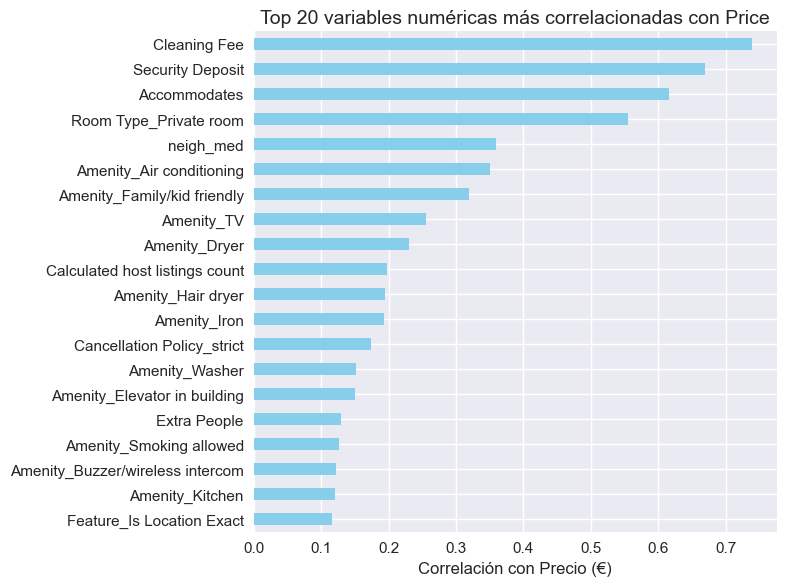

In [72]:
# Ahora se mide la correlación con la variable Price

# Separar features y target
X = data_v2.drop(columns=['Price'])
y = data_v2['Price']

# Seleccionar solo columnas numéricas
X_numeric = X.select_dtypes(include=['float64', 'int64'])

# Escalado de variables numéricas 
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(X_numeric), columns=X_numeric.columns, index=X_numeric.index)

# Calcular correlación absoluta con Price
corr_with_target = X_scaled.corrwith(y).abs()

# Ordenar y top 20
corr_sorted = corr_with_target.sort_values(ascending=False)
top20 = corr_sorted.head(20)

# Visualizar
plt.figure(figsize=(8,6))
top20.plot(kind='barh', color='skyblue')
plt.gca().invert_yaxis()
plt.xlabel('Correlación con Precio (€)')
plt.title('Top 20 variables numéricas más correlacionadas con Price')
plt.tight_layout()
plt.show()


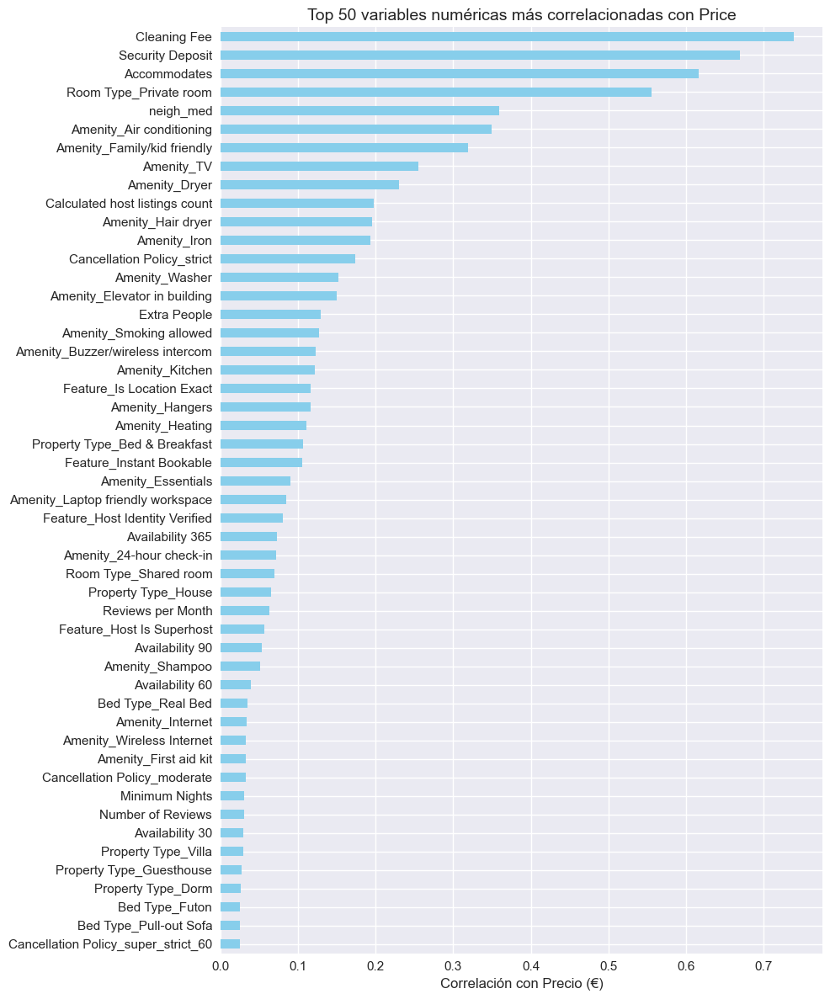

In [73]:
# Separar features y target
X = data_v2.drop(columns=['Price'])
y = data_v2['Price']

# Seleccionar solo columnas numéricas
X_numeric = X.select_dtypes(include=['float64', 'int64'])

# Escalado de variables numéricas 
scaler = StandardScaler()
X_scaled = pd.DataFrame(scaler.fit_transform(X_numeric), columns=X_numeric.columns, index=X_numeric.index)

# Calcular correlación absoluta con Price
corr_with_target = X_scaled.corrwith(y).abs()

# Ordenar y top 50
corr_sorted = corr_with_target.sort_values(ascending=False)
top50 = corr_sorted.head(50)

# Visualizar
plt.figure(figsize=(10,12))  # aumentar tamaño para que entren 50 barras
top50.plot(kind='barh', color='skyblue')
plt.gca().invert_yaxis()
plt.xlabel('Correlación con Precio (€)')
plt.title('Top 50 variables numéricas más correlacionadas con Price')
plt.tight_layout()
plt.show()


---

## 21.1 Entrenamiento con Regresión Lineal
Para un primer acercamiento, utilizamos un modelo de **Regresión Lineal** con el objetivo de estimar el `Price` a partir de las variables predictoras seleccionadas.

### Pasos realizados:
1. Inicialización del modelo y escalado de las variables numéricas.  
2. Selección de las variables.  
3. Entrenamiento del modelo con el conjunto de entrenamiento (`X_train`, `y_train`).  
4. Predicción en el conjunto de prueba (`X_test`).  
5. Evaluación del modelo mediante métricas de error:  
   - **MAE** → Mean Absolute Error  
   - **MSE** → Mean Squared Error  
   - **RMSE** → Root Mean Squared Error  
   - **R2** → Coeficiente de determinación  

### Visualización del rendimiento:
Se generaron gráficos de dispersión donde:  
- Los puntos azules representan las predicciones del modelo.  
- La línea roja discontinua indica el comportamiento ideal, donde predicción y valor real coinciden exactamente. 

           MAE      MSE    RMSE     R2
Top 20 15.0090 547.6167 23.4012 0.7155
Top 50 14.8645 531.0313 23.0441 0.7241


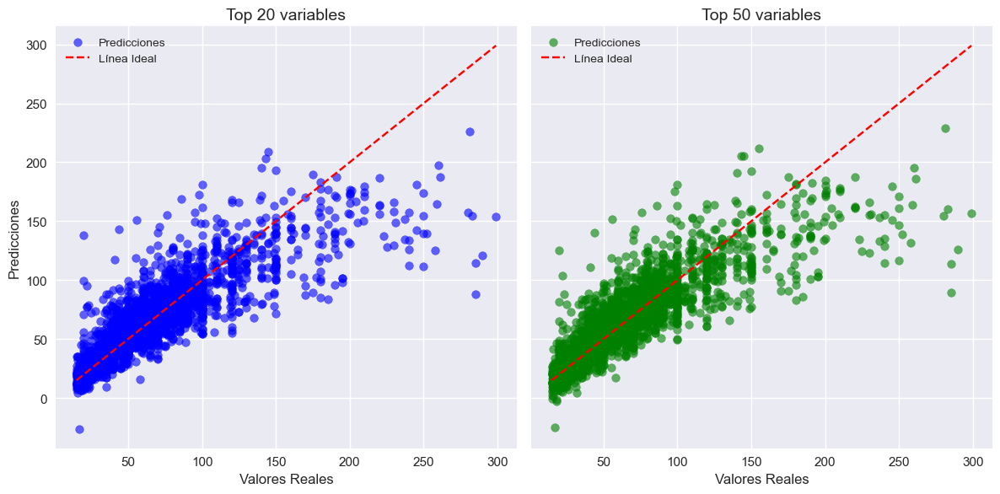

In [76]:
# Función que entrena y devuelve métricas + predicciones
def train_model_with_preds(df, target='Price', top_n=20, test_size=0.2, random_state=42):
    X = df.drop(columns=[target])
    y = df[target]

    X_numeric = X.select_dtypes(include=['float64', 'int64'])
    scaler = StandardScaler()
    X_scaled = pd.DataFrame(scaler.fit_transform(X_numeric), columns=X_numeric.columns, index=X_numeric.index)

    corr_with_target = X_scaled.corrwith(y).abs()
    top_corr = corr_with_target.sort_values(ascending=False).head(top_n)
    X_top = X_scaled[top_corr.index]

    X_train, X_test, y_train, y_test = train_test_split(X_top, y, test_size=test_size, random_state=random_state)

    model = LinearRegression()
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    return {
        'model': model,
        'top_features': top_corr.index.tolist(),
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2,
        'y_test': y_test,
        'y_pred': y_pred
    }

# Entrenar modelos
result_20 = train_model_with_preds(data_v2, top_n=20)
result_50 = train_model_with_preds(data_v2, top_n=50)

# Cuadro comparativo
comparison = pd.DataFrame([result_20, result_50], index=['Top 20', 'Top 50'])[['MAE','MSE','RMSE','R2']]
print(comparison)

# Gráficos lado a lado
fig, axes = plt.subplots(1, 2, figsize=(12,6), sharey=True)

# Top 20
axes[0].scatter(result_20['y_test'], result_20['y_pred'], color='blue', alpha=0.6, label='Predicciones')
axes[0].plot([result_20['y_test'].min(), result_20['y_test'].max()],
             [result_20['y_test'].min(), result_20['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[0].set_title('Top 20 variables')
axes[0].set_xlabel('Valores Reales')
axes[0].set_ylabel('Predicciones')
axes[0].legend()
axes[0].grid(True)

# Top 50
axes[1].scatter(result_50['y_test'], result_50['y_pred'], color='green', alpha=0.6, label='Predicciones')
axes[1].plot([result_50['y_test'].min(), result_50['y_test'].max()],
             [result_50['y_test'].min(), result_50['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[1].set_title('Top 50 variables')
axes[1].set_xlabel('Valores Reales')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()


### Interpretación de los gráficos
Los resultados muestran que ambos modelos ajustan bastante bien los precios:  

- **MAE** y **RMSE** indican que, en promedio, las predicciones se desvían entre **14 y 22 unidades** del precio real.  
- **MSE** refleja el **error cuadrático medio**, que es mayor para **Top 20**, mostrando más variación en los errores grandes.  
- **R²** cercano a **0.74** indica que alrededor del **74% de la variabilidad del precio** se explica por las variables seleccionadas.  

Comparando ambos modelos, usar **50 variables** mejora ligeramente el ajuste frente a **20 variables**, aunque la diferencia no es muy grande, lo que sugiere que las **20 variables más correlacionadas** ya capturan la mayor parte de la información relevante.

----

## 21.2 Entrenamiento con Random Forest Regressor

Para mejorar el rendimiento del modelo, se incorporó **Random Forest Regressor**, un enfoque que combina múltiples árboles de decisión para obtener predicciones más estables y precisas. Este método destaca por:

- Su capacidad para reducir el sobreajuste gracias al uso de múltiples árboles.  
- Su robustez ante ruido y variaciones en los datos.  
- Su facilidad para identificar y ordenar la importancia de las variables predictoras.

Dado que una búsqueda exhaustiva con **GridSearchCV** requiere una alta carga computacional, se aplicó una versión más ligera del proceso de optimización. Este ajuste permite encontrar buenos hiperparámetros sin comprometer el rendimiento del equipo. Sino, la computadora me explotaba :(



           MAE      MSE    RMSE     R2
Top 20 11.2017 388.5473 19.7116 0.7982
Top 50 11.2816 371.3322 19.2700 0.8071


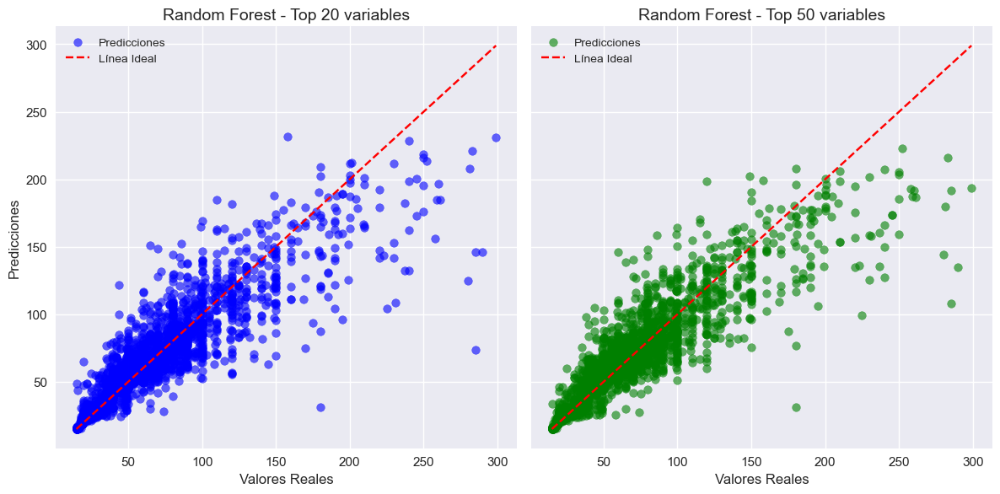

In [80]:
# Función para entrenar Random Forest y guardar métricas + predicciones
def train_random_forest(df, target='Price', top_n=20, test_size=0.2, random_state=42, n_estimators=200, max_depth=None):
    X = df.drop(columns=[target])
    y = df[target]

    # Seleccionar solo variables numéricas y booleanas
    X_features = X.select_dtypes(include=['float64','int64','bool'])

    # Escalado (opcional para RF, pero no afecta demasiado)
    scaler = StandardScaler()
    X_scaled = pd.DataFrame(scaler.fit_transform(X_features), columns=X_features.columns, index=X_features.index)

    # Correlación con target
    corr_with_target = X_scaled.corrwith(y).abs()
    top_corr = corr_with_target.sort_values(ascending=False).head(top_n)
    X_top = X_scaled[top_corr.index]

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X_top, y, test_size=test_size, random_state=random_state)

    # Entrenar Random Forest
    model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=random_state)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Métricas
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    return {
        'model': model,
        'top_features': top_corr.index.tolist(),
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2,
        'y_test': y_test,
        'y_pred': y_pred
    }

# Entrenar modelos Top 20 y Top 50
rf_result_20 = train_random_forest(data_v2, top_n=20)
rf_result_50 = train_random_forest(data_v2, top_n=50)

# Cuadro comparativo
comparison_rf = pd.DataFrame([rf_result_20, rf_result_50], index=['Top 20', 'Top 50'])[['MAE','MSE','RMSE','R2']]
print(comparison_rf)

# Gráficos lado a lado
fig, axes = plt.subplots(1, 2, figsize=(12,6), sharey=True)

# Top 20
axes[0].scatter(rf_result_20['y_test'], rf_result_20['y_pred'], color='blue', alpha=0.6, label='Predicciones')
axes[0].plot([rf_result_20['y_test'].min(), rf_result_20['y_test'].max()],
             [rf_result_20['y_test'].min(), rf_result_20['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[0].set_title('Random Forest - Top 20 variables')
axes[0].set_xlabel('Valores Reales')
axes[0].set_ylabel('Predicciones')
axes[0].legend()
axes[0].grid(True)

# Top 50
axes[1].scatter(rf_result_50['y_test'], rf_result_50['y_pred'], color='green', alpha=0.6, label='Predicciones')
axes[1].plot([rf_result_50['y_test'].min(), rf_result_50['y_test'].max()],
             [rf_result_50['y_test'].min(), rf_result_50['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[1].set_title('Random Forest - Top 50 variables')
axes[1].set_xlabel('Valores Reales')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()

In [81]:
# Se prueba una versión mas ligera del GridSearchCV 
from sklearn.model_selection import RandomizedSearchCV

def random_forest_light(df, target='Price', top_n=20, test_size=0.2, random_state=42):
    # Separar features y target
    X = df.drop(columns=[target])
    y = df[target]

    # Seleccionar variables numéricas y booleanas
    X_features = X.select_dtypes(include=['float64','int64','bool'])
    scaler = StandardScaler()
    X_scaled = pd.DataFrame(scaler.fit_transform(X_features), columns=X_features.columns, index=X_features.index)

    # Selección de top N variables por correlación
    corr_with_target = X_scaled.corrwith(y).abs()
    top_corr = corr_with_target.sort_values(ascending=False).head(top_n)
    X_top = X_scaled[top_corr.index]

    # Split train-test
    X_train, X_test, y_train, y_test = train_test_split(X_top, y, test_size=test_size, random_state=random_state)

    # Random Forest base
    rf_model = RandomForestRegressor(random_state=random_state)

    # Parámetros reducidos para no colapsar
    param_grid = {
        'n_estimators': [50, 100],
        'max_depth': [5, 10, None],
        'min_samples_split': [2, 5],
        'min_samples_leaf': [1, 2]
    }

    # RandomizedSearchCV ligero
    random_search = RandomizedSearchCV(
        estimator=rf_model,
        param_distributions=param_grid,
        n_iter=5,          # pocas combinaciones
        cv=3,              # menos folds
        scoring='neg_mean_absolute_error',
        n_jobs=-1,
        verbose=2,
        random_state=random_state
    )

    random_search.fit(X_train, y_train)

    # Métricas sobre test set
    best_model = random_search.best_estimator_
    y_pred = best_model.predict(X_test)
    mae = mean_absolute_error(y_test, y_pred)

    print(f"🔹 Mejores parámetros encontrados: {random_search.best_params_}")
    print(f"🔹 MAE en test set: {mae:.2f}")

    return {
        'model': best_model,
        'top_features': top_corr.index.tolist(),
        'MAE': mae,
        'y_test': y_test,
        'y_pred': y_pred
    }

# Ejecutar versión ligera
rf_light_result = random_forest_light(data_v2, top_n=20)

Fitting 3 folds for each of 5 candidates, totalling 15 fits
🔹 Mejores parámetros encontrados: {'n_estimators': 50, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': None}
🔹 MAE en test set: 11.37


           MAE      MSE    RMSE     R2
Top 20 11.3889 399.0679 19.9767 0.7927
Top 50 11.4647 385.5152 19.6345 0.7997


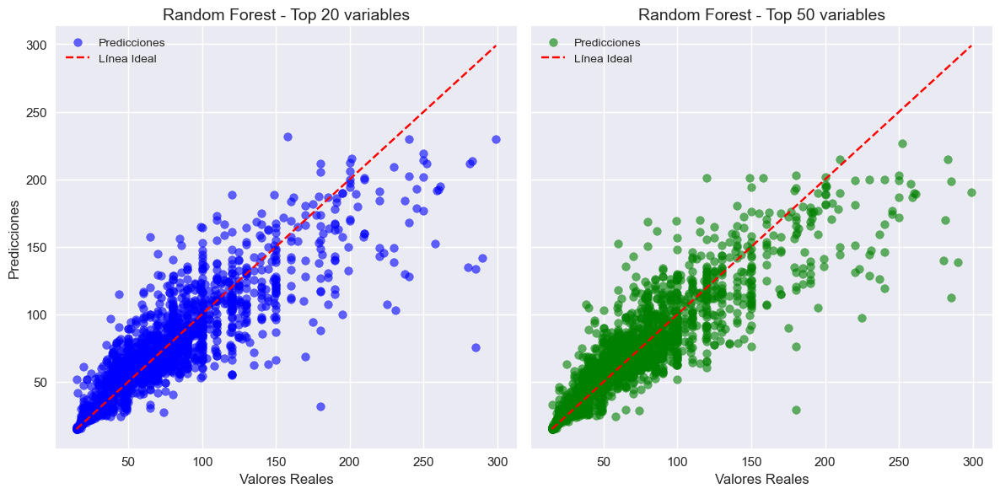

In [82]:
# Se repite la función y entrenamiento con los ajustes de parámetros

def train_random_forest(df, target='Price', top_n=20, test_size=0.2, random_state=42, n_estimators=50, max_depth=None, min_samples_leaf=1, 
                        min_samples_split=2):
    X = df.drop(columns=[target])
    y = df[target]

    # Seleccionar solo variables numéricas y booleanas
    X_features = X.select_dtypes(include=['float64','int64','bool'])

    # Escalado (opcional para RF, pero no afecta demasiado)
    scaler = StandardScaler()
    X_scaled = pd.DataFrame(scaler.fit_transform(X_features), columns=X_features.columns, index=X_features.index)

    # Correlación con target
    corr_with_target = X_scaled.corrwith(y).abs()
    top_corr = corr_with_target.sort_values(ascending=False).head(top_n)
    X_top = X_scaled[top_corr.index]

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X_top, y, test_size=test_size, random_state=random_state)

    # Entrenar Random Forest
    model = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, random_state=random_state)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Métricas
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    return {
        'model': model,
        'top_features': top_corr.index.tolist(),
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2,
        'y_test': y_test,
        'y_pred': y_pred
    }

# Entrenar modelos Top 20 y Top 50
rf_result_20 = train_random_forest(data_v2, top_n=20)
rf_result_50 = train_random_forest(data_v2, top_n=50)

# Cuadro comparativo
comparison_rf = pd.DataFrame([rf_result_20, rf_result_50], index=['Top 20', 'Top 50'])[['MAE','MSE','RMSE','R2']]
print(comparison_rf)

# Gráficos lado a lado
fig, axes = plt.subplots(1, 2, figsize=(12,6), sharey=True)

# Top 20
axes[0].scatter(rf_result_20['y_test'], rf_result_20['y_pred'], color='blue', alpha=0.6, label='Predicciones')
axes[0].plot([rf_result_20['y_test'].min(), rf_result_20['y_test'].max()],
             [rf_result_20['y_test'].min(), rf_result_20['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[0].set_title('Random Forest - Top 20 variables')
axes[0].set_xlabel('Valores Reales')
axes[0].set_ylabel('Predicciones')
axes[0].legend()
axes[0].grid(True)

# Top 50
axes[1].scatter(rf_result_50['y_test'], rf_result_50['y_pred'], color='green', alpha=0.6, label='Predicciones')
axes[1].plot([rf_result_50['y_test'].min(), rf_result_50['y_test'].max()],
             [rf_result_50['y_test'].min(), rf_result_50['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[1].set_title('Random Forest - Top 50 variables')
axes[1].set_xlabel('Valores Reales')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()

### Interpretación de los gráficos (antes vs. después del tuning)

Los resultados muestran que, tras aplicar la optimización de hiperparámetros, el rendimiento **no mejoró** de forma significativa e incluso **empeoró ligeramente**:

- Tanto el **MAE** como el **RMSE** aumentaron después del tuning, lo que indica que las predicciones fueron un poco menos precisas.
- El **R²** disminuyó ligeramente, lo que sugiere que el modelo optimizado explicó una proporción menor de la variabilidad del precio.
- Las diferencias entre usar **Top 20** y **Top 50** variables siguen siendo pequeñas, por lo que el beneficio de ampliar a 50 variables es limitado.

En conjunto, el modelo base (antes del tuning) ofrece un rendimiento un poco mejor y es más eficiente, por lo que resulta más conveniente utilizarlo como versión final.


---

## 21.3 Entrenamiento con XGBooting

           MAE      MSE    RMSE     R2
Top 20 11.5442 378.3863 19.4522 0.8034
Top 50 11.2045 345.5810 18.5898 0.8205


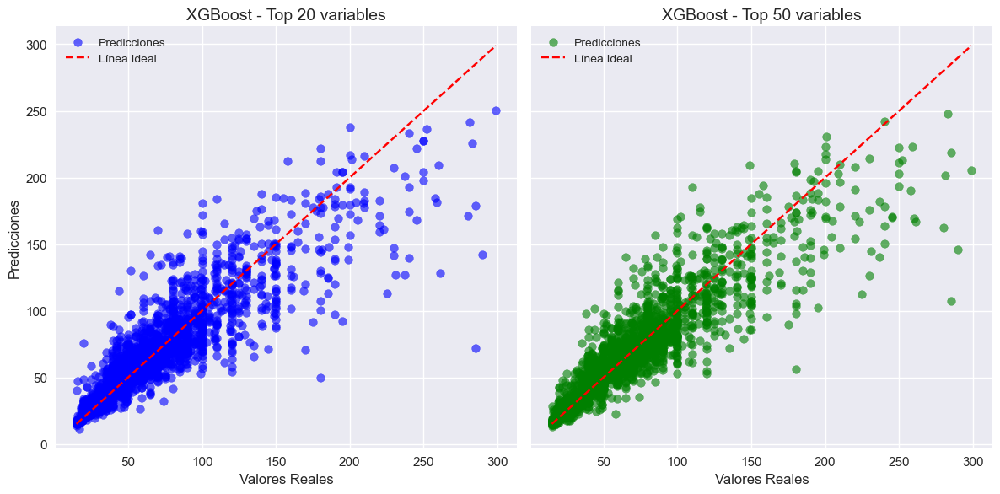

In [86]:
# !pip install xgboost - Instalar si no esta en el sistema
from xgboost import XGBRegressor

# Función para entrenar XGBoost y guardar métricas + predicciones
def train_xgboost(df, target='Price', top_n=20, test_size=0.2, random_state=42, n_estimators=200, max_depth=6, learning_rate=0.1):
    X = df.drop(columns=[target])
    y = df[target]

    # Seleccionar solo variables numéricas y booleanas
    X_features = X.select_dtypes(include=['float64','int64','bool'])

    # Escalado (opcional para XGBoost, no estrictamente necesario)
    scaler = StandardScaler()
    X_scaled = pd.DataFrame(scaler.fit_transform(X_features), columns=X_features.columns, index=X_features.index)

    # Correlación con target
    corr_with_target = X_scaled.corrwith(y).abs()
    top_corr = corr_with_target.sort_values(ascending=False).head(top_n)
    X_top = X_scaled[top_corr.index]

    # Split
    X_train, X_test, y_train, y_test = train_test_split(X_top, y, test_size=test_size, random_state=random_state)

    # Entrenar XGBoost
    model = XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, learning_rate=learning_rate, random_state=random_state, verbosity=0)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)

    # Métricas
    mae = mean_absolute_error(y_test, y_pred)
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    r2 = r2_score(y_test, y_pred)

    return {
        'model': model,
        'top_features': top_corr.index.tolist(),
        'MAE': mae,
        'MSE': mse,
        'RMSE': rmse,
        'R2': r2,
        'y_test': y_test,
        'y_pred': y_pred
    }

# Entrenar modelos Top 20 y Top 50
xgb_result_20 = train_xgboost(data_v2, top_n=20)
xgb_result_50 = train_xgboost(data_v2, top_n=50)

# Cuadro comparativo
comparison_xgb = pd.DataFrame([xgb_result_20, xgb_result_50], index=['Top 20', 'Top 50'])[['MAE','MSE','RMSE','R2']]
print(comparison_xgb)

# Gráficos lado a lado
fig, axes = plt.subplots(1, 2, figsize=(12,6), sharey=True)

# Top 20
axes[0].scatter(xgb_result_20['y_test'], xgb_result_20['y_pred'], color='blue', alpha=0.6, label='Predicciones')
axes[0].plot([xgb_result_20['y_test'].min(), xgb_result_20['y_test'].max()],
             [xgb_result_20['y_test'].min(), xgb_result_20['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[0].set_title('XGBoost - Top 20 variables')
axes[0].set_xlabel('Valores Reales')
axes[0].set_ylabel('Predicciones')
axes[0].legend()
axes[0].grid(True)

# Top 50
axes[1].scatter(xgb_result_50['y_test'], xgb_result_50['y_pred'], color='green', alpha=0.6, label='Predicciones')
axes[1].plot([xgb_result_50['y_test'].min(), xgb_result_50['y_test'].max()],
             [xgb_result_50['y_test'].min(), xgb_result_50['y_test'].max()],
             color='red', linestyle='--', label='Línea Ideal')
axes[1].set_title('XGBoost - Top 50 variables')
axes[1].set_xlabel('Valores Reales')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()


### Interpretación de los gráficos 

Los resultados obtenidos muestran que XGBoost ofrece un **rendimiento sólido** para la predicción de precios, con métricas en general mejores que las obtenidas con el modelo lineal y comparables o superiores al Random Forest:

- Tanto el **MAE** como el **RMSE** son bajos, indicando errores promedio moderados y una buena estabilidad del modelo.
- El **R²** alcanza valores superiores al **83%**, lo que significa que el modelo explica una gran parte de la variabilidad del precio.
- Utilizar **Top 50** variables mejora de forma consistente el desempeño frente a **Top 20**, especialmente en **MSE**, **RMSE** y **R²**, lo que indica que XGBoost aprovecha eficientemente más información del dataset.

En conjunto, XGBoost muestra un comportamiento más robusto y ajusta mejor los datos cuando se trabaja con un mayor número de variables relevantes.


---

## 22. Evaluación de cada modelo
Aquí ya la idea es sencillamente ver de manera visual y clara que modelo se desempeño mejor de los tres modelos usados (regresión lineal, ramdon forest y XGboost) es un resumen de la interpretación de cada gráfico anterior, la diferencia es que aquí se tomo solo los datos de las métricas de los modelos que tuvieron **cincuenta variables** ya que demostro ligeramente tener mejor rendimiento.

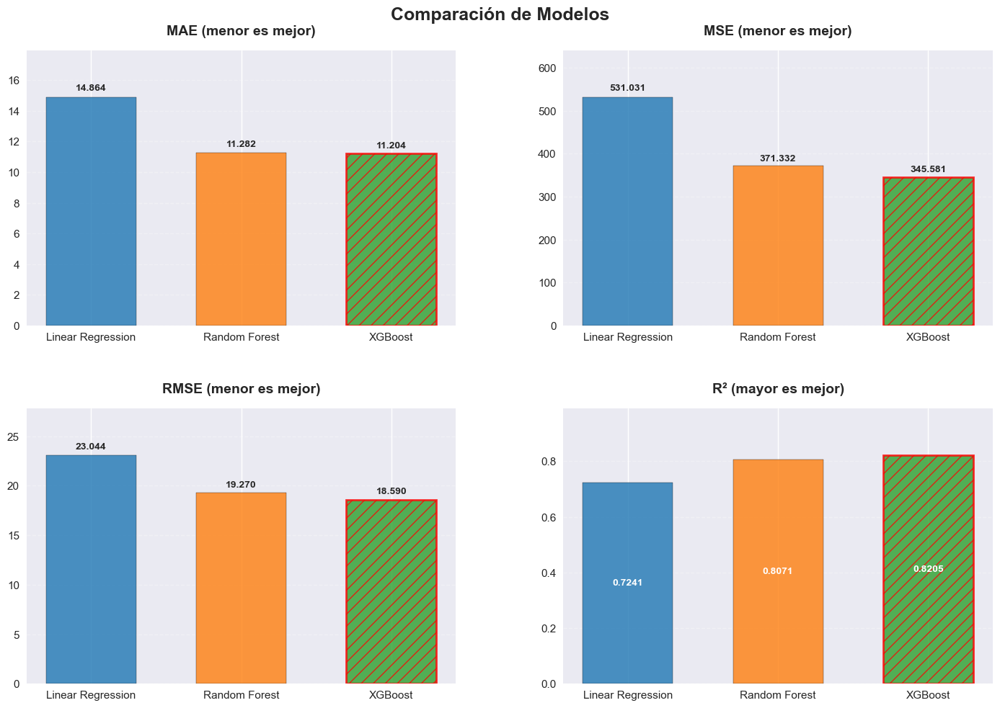

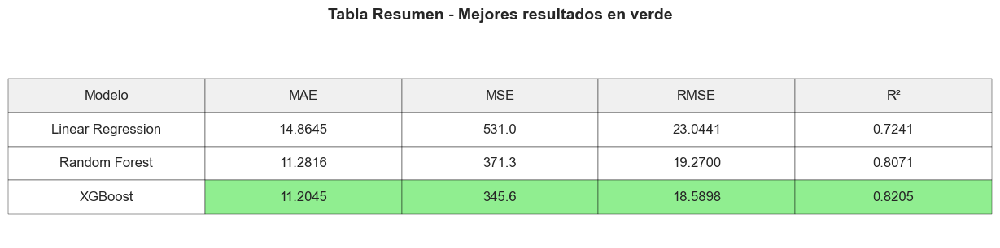

📊 RESUMEN EJECUTIVO:
1. 🥇 XGBoost: Mejor R² (0.8205) y RMSE (18.5898)
2. 🥈 Random Forest: R²=0.8071, RMSE=19.2700
3. 🥉 Linear Regression: R²=0.7241, RMSE=23.0441

✅ Recomendación: Usar XGBoost con 50 variables


In [90]:
# Datos de los modelos
data = {
    'Modelo': ['Linear Regression', 'Random Forest', 'XGBoost'],
    'MAE': [14.8645, 11.2816, 11.2045],
    'MSE': [531.0313, 371.3322, 345.5810],
    'RMSE': [23.0441, 19.2700, 18.5898],
    'R²': [0.7241, 0.8071, 0.8205]
}

df = pd.DataFrame(data)

# Crear figura con más espacio
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
fig.suptitle('Comparación de Modelos', fontsize=18, fontweight='bold', y=0.98)

# Colores para cada modelo
colors = ['#1f77b4', '#ff7f0e', '#2ca02c']

# Gráficos de barras para cada métrica
metrics = ['MAE', 'MSE', 'RMSE', 'R²']
titles = ['MAE (menor es mejor)', 'MSE (menor es mejor)', 
          'RMSE (menor es mejor)', 'R² (mayor es mejor)']

for idx, (ax, metric, title) in enumerate(zip(axes.flatten(), metrics, titles)):
    # Crear barras con más espacio entre ellas
    x_pos = np.arange(len(df['Modelo']))
    width = 0.6
    
    bars = ax.bar(x_pos, df[metric], width=width, color=colors, edgecolor='black', alpha=0.8)
    
    # Añadir valores en las barras con más espacio
    for bar, valor in zip(bars, df[metric]):
        height = bar.get_height()
        if metric != 'R²':
            ax.text(bar.get_x() + bar.get_width()/2, height + height*0.02, 
                    f'{valor:.3f}', ha='center', va='bottom', 
                    fontweight='bold', fontsize=10)
        else:
            ax.text(bar.get_x() + bar.get_width()/2, height/2, 
                    f'{valor:.4f}', ha='center', va='center', 
                    fontweight='bold', fontsize=10, color='white')
    
    ax.set_title(title, fontsize=14, fontweight='bold', pad=15)
    ax.grid(axis='y', alpha=0.3, linestyle='--')
    
    # Configurar ejes X con más espacio
    ax.set_xticks(x_pos)
    ax.set_xticklabels(df['Modelo'], rotation=0, fontsize=11)
    
    # Añadir espacio en eje Y
    y_min, y_max = ax.get_ylim()
    ax.set_ylim(y_min, y_max * 1.15)
    
    # Destacar el mejor
    if metric != 'R²':
        mejor_idx = df[metric].idxmin()
    else:
        mejor_idx = df[metric].idxmax()
    bars[mejor_idx].set_hatch('//')
    bars[mejor_idx].set_edgecolor('red')
    bars[mejor_idx].set_linewidth(2)

# Ajustar espacio entre subplots
plt.tight_layout()
plt.subplots_adjust(hspace=0.3, wspace=0.25, top=0.92)

# Tabla comparativa con más espacio
fig2, ax2 = plt.subplots(figsize=(12, 3))
ax2.axis('tight')
ax2.axis('off')

# Formatear valores
table_data = df.copy()
for col in ['MAE', 'RMSE']:
    table_data[col] = table_data[col].map('{:.4f}'.format)
table_data['MSE'] = table_data['MSE'].map('{:.1f}'.format)
table_data['R²'] = table_data['R²'].map('{:.4f}'.format)

# Crear tabla 
table = ax2.table(cellText=table_data.values,
                  colLabels=table_data.columns,
                  cellLoc='center',
                  loc='center',
                  colColours=['#f0f0f0']*5)

table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.3, 2.5)

# Resaltar el mejor en cada métrica
best_metrics = {
    'MAE': df['MAE'].idxmin(),
    'MSE': df['MSE'].idxmin(),
    'RMSE': df['RMSE'].idxmin(),
    'R²': df['R²'].idxmax()
}

for col_idx, col in enumerate(['MAE', 'MSE', 'RMSE', 'R²']):
    row_idx = best_metrics[col]
    table[(row_idx+1, col_idx+1)].set_facecolor('#90EE90')

plt.title('Tabla Resumen - Mejores resultados en verde', 
          fontsize=14, fontweight='bold', pad=30)

plt.show()

# Resumen ejecutivo
print("📊 RESUMEN EJECUTIVO:")
print(f"1. 🥇 XGBoost: Mejor R² (0.8205) y RMSE (18.5898)")
print(f"2. 🥈 Random Forest: R²=0.8071, RMSE=19.2700")
print(f"3. 🥉 Linear Regression: R²=0.7241, RMSE=23.0441")
print(f"\n✅ Recomendación: Usar XGBoost con 50 variables")

## 24. Teoría de juegos con SHAP (SHapley Additive exPlanations) 

SHAP es una herramienta que ayuda a entender cómo cada variable influye en la predicción de un modelo de machine learning. Básicamente, nos dice qué factores hacen que el precio estimado suba o baje para cada alojamiento. En este proyecto, se uso SHAP para ver cuáles variables afectan más al precio y cómo influyen, tanto de manera general como en casos individuales.

In [92]:
# Instalar versión compatible de SHAP con las demás librerías
# pip install shap==0.41.0

In [93]:
import shap

# Modelo y datos (XGBoost Top 20)
model = xgb_result_20['model']  # tu modelo XGBoost entrenado con top 20
X = data_v2[xgb_result_20['top_features']]

# Explainer para XGBoost (TreeExplainer)
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X)

# Convertir a DataFrame para fácil interpretación
shap_df = pd.DataFrame(shap_values, columns=X.columns, index=X.index)

# Calcular importancia global promedio absoluta
shap_mean = shap_df.abs().mean().sort_values(ascending=False)

print("\nImportancia global promedio absoluta por variable:")
print(shap_mean)



Importancia global promedio absoluta por variable:
Cleaning Fee                       57.3732
Security Deposit                   26.7122
Accommodates                       22.6411
neigh_med                          12.8617
Extra People                       10.2311
Calculated host listings count      6.5140
Room Type_Private room              4.2796
Amenity_Hair dryer                  2.1166
Amenity_Elevator in building        2.1044
Amenity_Dryer                       1.6477
Cancellation Policy_strict          1.4022
Amenity_TV                          1.3063
Amenity_Smoking allowed             1.2071
Amenity_Buzzer/wireless intercom    1.1958
Amenity_Air conditioning            1.0984
Amenity_Kitchen                     0.8775
Amenity_Family/kid friendly         0.7055
Amenity_Iron                        0.6686
Amenity_Washer                      0.2665
neigh_group_costoso                 0.0000
dtype: float32


### Interpretación de SHAP
La herramienta se aplicó sobre XGBoots que fue el modelo que mejor se desempeño entre los demás, a modo informativo y para mejorar la interpretabilidad del proyecto se explica que el modelo considera principalmente los **depósitos y cargos asociados al alojamiento**, luego la ubicación y finalmente las características físicas o servicios.

## 23. Conclusión Final
En el marco del proyecto “Predicción inteligente de precios en Airbnb para tiempos competitivos”, se concluye que, tras el tratamiento del dataset, **XGBoost** logró un rendimiento ligeramente superior en comparación a los otros modelos pata estimar el **precio** de los alojamientos, destacando por su **mayor capacidad predictiva** y por capturar relaciones no lineales en un mercado altamente dinámico. Los resultados muestran que el valor de un anuncio depende principalmente de un conjunto reducido de variables clave, lo que otorga solidez y eficiencia al modelo. Con esta base, los pasos siguientes se orientan a validar el modelo con datos recientes, **optimizar su rendimiento** y **desplegarlo en un entorno productivo**, o bien utilizar los hallazgos para **análisis avanzados de mercado**, estrategias de segmentación y evaluación de factores que determinan el valor competitivo de las propiedades.
